# Assignment

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
content_path = "/content/drive/MyDrive/Colab Notebooks/dataset/content_nthu.jpg"
style_path = "/content/drive/MyDrive/Colab Notebooks/dataset/style_starry_night.jpg"

Mounted at /content/drive


In [1]:
%matplotlib inline
import tensorflow as tf
import numpy as np
import time, os
import functools
import IPython.display as display
from pathlib import Path
import random
from PIL import Image
from matplotlib import pyplot
import matplotlib.pyplot as plt
import matplotlib as mpl

mpl.rcParams['figure.figsize'] = (12,12)
mpl.rcParams['axes.grid'] = False

In [2]:
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        # Restrict TensorFlow to only use the fourth GPU
        tf.config.experimental.set_visible_devices(gpus[0], 'GPU')

        # Currently, memory growth needs to be the same across GPUs
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)
        logical_gpus = tf.config.experimental.list_logical_devices('GPU')
        print(len(gpus), "Physical GPUs,", len(logical_gpus), "Logical GPUs")
    except RuntimeError as e:
        # Memory growth must be set before GPUs have been initialized
        print(e)

1 Physical GPUs, 1 Logical GPUs


# Part I (A Neural Algorithm of Artistic Style)

In [ ]:
def load_img(path_to_img):
    max_dim = 512
    img = tf.io.read_file(path_to_img)
    img = tf.image.decode_image(img, channels=3)
    img = tf.image.convert_image_dtype(img, tf.float32)

    shape = tf.cast(tf.shape(img)[:-1], tf.float32)
    long_dim = max(shape)
    scale = max_dim / long_dim

    new_shape = tf.cast(shape * scale, tf.int32)

    img = tf.image.resize(img, new_shape)
    # in order to use CNN, add one additional dimension 
    # to the original image
    # img shape: [height, width, channel] -> [batch_size, height, width, channel]
    img = img[tf.newaxis, :]
    
    return img

def imshow(image, title=None):
    if len(image.shape) > 3:
        image = tf.squeeze(image, axis=0)

    plt.imshow(image)
    if title:
        plt.title(title)

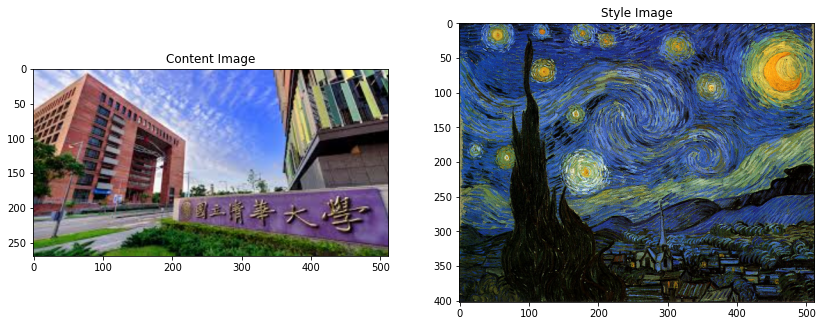

In [ ]:
content_path = './dataset/content_nthu.jpg'
style_path = './dataset/style_starry_night.jpg'

content_image = load_img(content_path)
style_image = load_img(style_path)

plt.figure(figsize=(14,10))
plt.subplot(1, 2, 1)
imshow(content_image, 'Content Image')

plt.subplot(1, 2, 2)
imshow(style_image, 'Style Image')

In [ ]:
vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')

print()
for layer in vgg.layers:
    print(layer.name)

80150528/80134624 [==============================] - 1s 0us/step

input_1
block1_conv1
block1_conv2
block1_pool
block2_conv1
block2_conv2
block2_pool
block3_conv1
block3_conv2
block3_conv3
block3_conv4
block3_pool
block4_conv1
block4_conv2
block4_conv3
block4_conv4
block4_pool
block5_conv1
block5_conv2
block5_conv3
block5_conv4
block5_pool


In [ ]:
# Content layer where will pull our feature maps
content_layers = ['block5_conv2'] 

# Style layer of interest
style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

In [ ]:
def vgg_layers(layer_names):
    """ Creates a vgg model that returns a list of intermediate output values."""
    # Load our model. Load pretrained VGG, trained on imagenet data
    vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
    vgg.trainable = False

    outputs = [vgg.get_layer(name).output for name in layer_names]

    model = tf.keras.Model([vgg.input], outputs)
    return model

In [ ]:
style_extractor = vgg_layers(style_layers)
style_outputs = style_extractor(style_image*255)

#Look at the statistics of each layer's output
for name, output in zip(style_layers, style_outputs):
    print(name)
    print("  shape: ", output.numpy().shape)
    print("  min: ", output.numpy().min())
    print("  max: ", output.numpy().max())
    print("  mean: ", output.numpy().mean())
    print()

block1_conv1
  shape:  (1, 402, 512, 64)
  min:  0.0
  max:  742.4454
  mean:  22.595304

block2_conv1
  shape:  (1, 201, 256, 128)
  min:  0.0
  max:  3492.055
  mean:  139.87125

block3_conv1
  shape:  (1, 100, 128, 256)
  min:  0.0
  max:  6940.378
  mean:  147.91318

block4_conv1
  shape:  (1, 50, 64, 512)
  min:  0.0
  max:  15697.7
  mean:  543.7416

block5_conv1
  shape:  (1, 25, 32, 512)
  min:  0.0
  max:  4195.862
  mean:  47.641136



## Calculate style

In [ ]:
def gram_matrix(input_tensor):
    result = tf.linalg.einsum('bijc,bijd->bcd', input_tensor, input_tensor)
    input_shape = tf.shape(input_tensor)
    num_locations = tf.cast(input_shape[1]*input_shape[2], tf.float32)
    return result/(num_locations)

## Extract style and content

In [ ]:
class StyleContentModel(tf.keras.models.Model):
    def __init__(self, style_layers, content_layers):
        super(StyleContentModel, self).__init__()
        self.vgg =  vgg_layers(style_layers + content_layers)
        self.style_layers = style_layers
        self.content_layers = content_layers
        self.num_style_layers = len(style_layers)
        self.vgg.trainable = False

    def call(self, inputs):
        "Expects float input in [0,1]"
        inputs = inputs*255.0
        preprocessed_input = tf.keras.applications.vgg19.preprocess_input(inputs)
        outputs = self.vgg(preprocessed_input)
        style_outputs, content_outputs = (outputs[:self.num_style_layers], 
                                          outputs[self.num_style_layers:])

        style_outputs = [gram_matrix(style_output)
                         for style_output in style_outputs]

        content_dict = {content_name:value 
                        for content_name, value 
                        in zip(self.content_layers, content_outputs)}

        style_dict = {style_name:value
                      for style_name, value
                      in zip(self.style_layers, style_outputs)}

        return {'content':content_dict, 'style':style_dict}

In [ ]:
extractor = StyleContentModel(style_layers, content_layers)

results = extractor(tf.constant(content_image))

style_results = results['style']

print('Styles:')
for name, output in sorted(results['style'].items()):
    print("  ", name)
    print("    shape: ", output.numpy().shape)
    print("    min: ", output.numpy().min())
    print("    max: ", output.numpy().max())
    print("    mean: ", output.numpy().mean())
    print()

print("Contents:")
for name, output in sorted(results['content'].items()):
    print("  ", name)
    print("    shape: ", output.numpy().shape)
    print("    min: ", output.numpy().min())
    print("    max: ", output.numpy().max())
    print("    mean: ", output.numpy().mean())

Styles:
   block1_conv1
    shape:  (1, 64, 64)
    min:  0.023810934
    max:  18674.498
    mean:  743.52576

   block2_conv1
    shape:  (1, 128, 128)
    min:  0.0
    max:  111471.75
    mean:  20621.188

   block3_conv1
    shape:  (1, 256, 256)
    min:  1.0352992
    max:  739126.1
    mean:  21373.393

   block4_conv1
    shape:  (1, 512, 512)
    min:  0.0
    max:  5888397.0
    mean:  287949.28

   block5_conv1
    shape:  (1, 512, 512)
    min:  0.0
    max:  114889.21
    mean:  2506.202

Contents:
   block5_conv2
    shape:  (1, 16, 32, 512)
    min:  0.0
    max:  942.2925
    mean:  18.336668


## Define loss

In [ ]:
def style_content_loss(outputs):
    style_outputs = outputs['style']
    content_outputs = outputs['content']
    style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
                           for name in style_outputs.keys()])
    style_loss *= style_weight / num_style_layers

    content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
                             for name in content_outputs.keys()])
    content_loss *= content_weight / num_content_layers
    
    loss = style_loss + content_loss
    return loss   

In [ ]:
def shift_image(image, di=0, dj=0):
    img = tf.image.crop_to_bounding_box(image, di, dj, image.shape[1] - di, image.shape[2] - dj)
    img = tf.image.pad_to_bounding_box(img, 0, 0, image.shape[1], image.shape[2])
    return img

def total_variation_loss(image, up, lf):
    # up = shift_image(image, di=1)
    # lf = shift_image(image, dj=1)
    extra_term_col = tf.slice(image[0], [0, image.shape[2]-1, 0], [image.shape[1], 1, 3])
    extra_term_row = tf.slice(image[0], [image.shape[1]-1, 0, 0], [1, image.shape[2], 3])
    loss = (tf.reduce_sum(tf.abs(up-image)) + tf.reduce_sum(tf.abs(lf-image))
            - tf.reduce_sum(extra_term_col) - tf.reduce_sum(extra_term_row))
    return loss

# Verify the correctness of total variation loss
image = tf.Variable(content_image)
print(total_variation_loss(image, shift_image(image, di=1), shift_image(image, dj=1)))
print(tf.image.total_variation(image))

tf.Tensor(27254.271, shape=(), dtype=float32)
tf.Tensor([27254.271], shape=(1,), dtype=float32)


## Gradient descent

In [ ]:
def clip_0_1(image):
    return tf.clip_by_value(image, clip_value_min=0.0, clip_value_max=1.0)

In [ ]:
@tf.function()
def train_step(image):
    with tf.GradientTape() as tape:        
        outputs = extractor(image)
        loss = style_content_loss(outputs)
        
        up = shift_image(image, di=1)
        lf = shift_image(image, dj=1)
        loss += total_variation_weight*total_variation_loss(image, up, lf)

    grad = tape.gradient(loss, image)
    opt.apply_gradients([(grad, image)])
    image.assign(clip_0_1(image))

## Weight tuning

In [ ]:
image = tf.Variable(content_image)

style_targets = extractor(style_image)['style']
content_targets = extractor(content_image)['content']

opt = tf.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)
style_weight_list = [0.01, 0.1, 1, 10, 100]
content_weight_list = [1]
total_variation_weight_list = [0.001, 0.1, 1, 10, 1000]

Style: 0.01, Content: 1, Total variation: 0.001


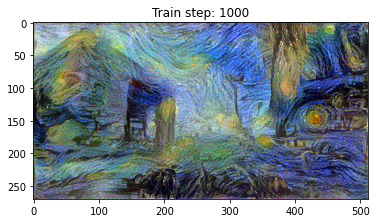

Style: 0.01, Content: 1, Total variation: 0.1


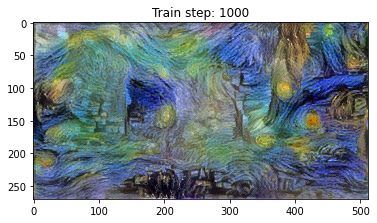

Style: 0.01, Content: 1, Total variation: 1


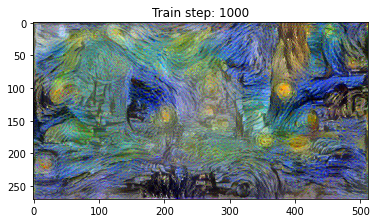

Style: 0.01, Content: 1, Total variation: 10


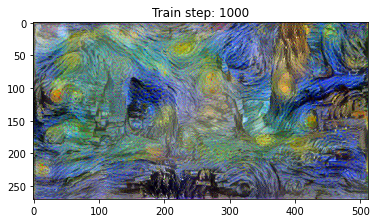

Style: 0.01, Content: 1, Total variation: 1000


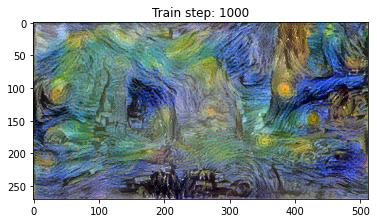

Style: 0.1, Content: 1, Total variation: 0.001


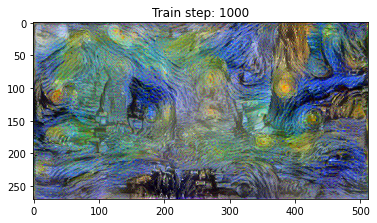

Style: 0.1, Content: 1, Total variation: 0.1


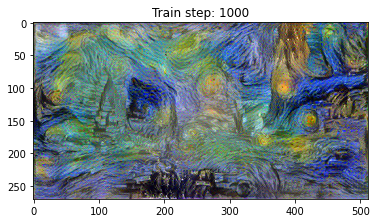

Style: 0.1, Content: 1, Total variation: 1


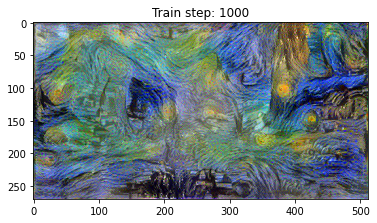

Style: 0.1, Content: 1, Total variation: 10


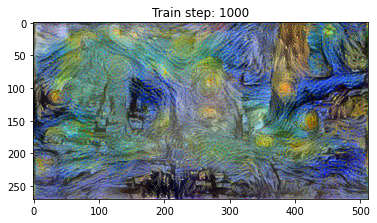

Style: 0.1, Content: 1, Total variation: 1000


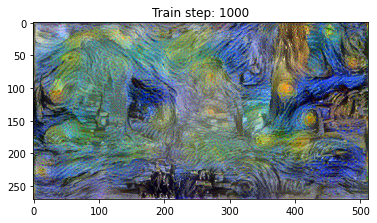

Style: 1, Content: 1, Total variation: 0.001


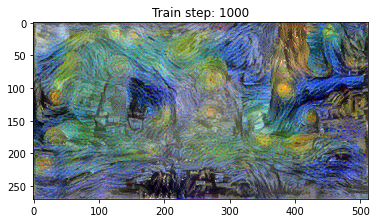

Style: 1, Content: 1, Total variation: 0.1


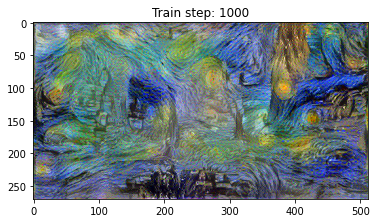

Style: 1, Content: 1, Total variation: 1


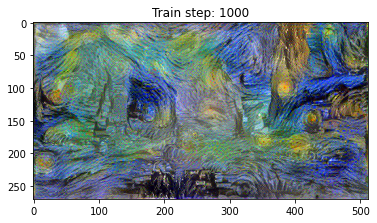

Style: 1, Content: 1, Total variation: 10


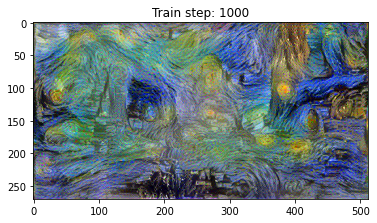

Style: 1, Content: 1, Total variation: 1000


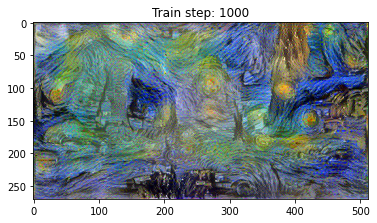

Style: 10, Content: 1, Total variation: 0.001


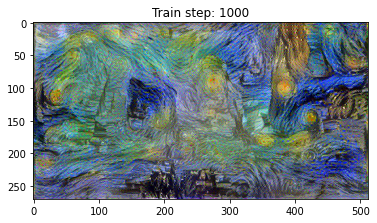

Style: 10, Content: 1, Total variation: 0.1


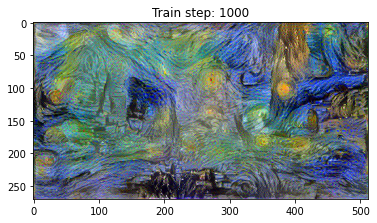

Style: 10, Content: 1, Total variation: 1


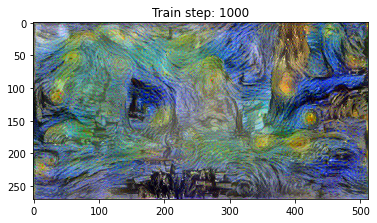

Style: 10, Content: 1, Total variation: 10


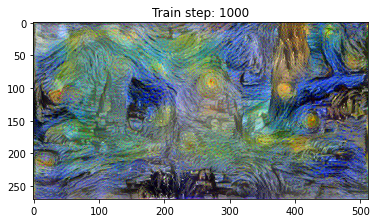

Style: 10, Content: 1, Total variation: 1000


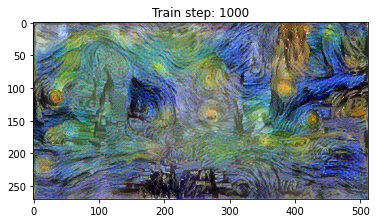

Style: 100, Content: 1, Total variation: 0.001


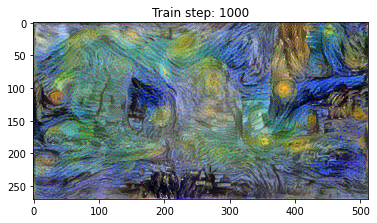

Style: 100, Content: 1, Total variation: 0.1


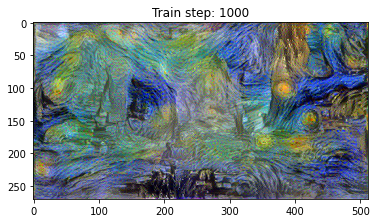

Style: 100, Content: 1, Total variation: 1


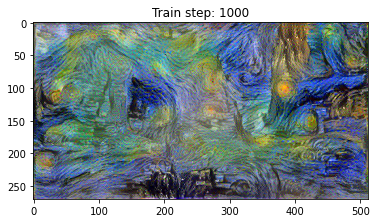

Style: 100, Content: 1, Total variation: 10


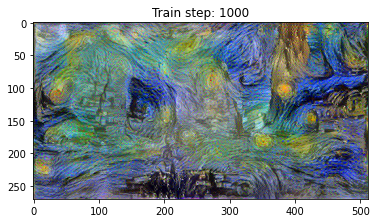

Style: 100, Content: 1, Total variation: 1000


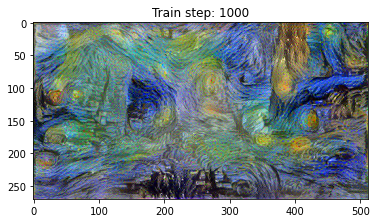

Total time: 4831.2


In [ ]:
start = time.time()

epochs = 10
steps_per_epoch = 100

for s in style_weight_list:
  for c in content_weight_list:
    for v in total_variation_weight_list:
      print(f'Style: {s}, Content: {c}, Total variation: {v}')
      
      image = tf.Variable(content_image)
      style_weight, content_weight, total_variation_weight = s, c, v
      step = 0
      
      for n in range(epochs):
          for m in range(steps_per_epoch):
              step += 1
              train_step(image)
      imshow(image.read_value()[0])
      plt.title("Train step: {}".format(step))
      plt.show()
      
      # file_name = f'./output/style_transfer_nthu_starry_night_s{s*100}_c{c}_v{v*10}.png'
      file_name = f'/content/drive/MyDrive/Colab Notebooks/output/style_transfer_nthu_starry_night_s{s*100}_c{c}_v{v*10}.png'
      mpl.image.imsave(file_name, image[0].numpy())

end = time.time()
print("Total time: {:.1f}".format(end-start))

## Try other layers

In [ ]:
for layer in vgg.layers:
    print(layer.name)

input_1
block1_conv1
block1_conv2
block1_pool
block2_conv1
block2_conv2
block2_pool
block3_conv1
block3_conv2
block3_conv3
block3_conv4
block3_pool
block4_conv1
block4_conv2
block4_conv3
block4_conv4
block4_pool
block5_conv1
block5_conv2
block5_conv3
block5_conv4
block5_pool


In [ ]:
# Content layer where will pull our feature maps
content_layers = ['block1_conv2'] 

# Style layer of interest
style_layers = ['block1_conv1',
                'block2_conv1',
                'block3_conv1', 
                'block4_conv1', 
                'block5_conv1']

num_content_layers = len(content_layers)
num_style_layers = len(style_layers)

extractor = StyleContentModel(style_layers, content_layers)

In [ ]:
image = tf.Variable(content_image)

style_targets = extractor(style_image)['style']
content_targets = extractor(content_image)['content']

opt = tf.optimizers.Adam(learning_rate=0.02, beta_1=0.99, epsilon=1e-1)
style_weight = 1
content_weight = 1
total_variation_weight = 1

In [ ]:
def output_loss(outputs):
    style_outputs = outputs['style']
    content_outputs = outputs['content']
    style_loss = tf.add_n([tf.reduce_mean((style_outputs[name]-style_targets[name])**2) 
                           for name in style_outputs.keys()])
    style_loss *= style_weight / num_style_layers

    content_loss = tf.add_n([tf.reduce_mean((content_outputs[name]-content_targets[name])**2) 
                             for name in content_outputs.keys()])
    content_loss *= content_weight / num_content_layers
    
    print(f'Style loss:\t{style_loss:.4f}\nContent loss:\t{content_loss:.4f}')
    return style_loss, content_loss

style_loss = []    
content_loss = []

Style loss:	11669535.0000
Content loss:	33941.1250


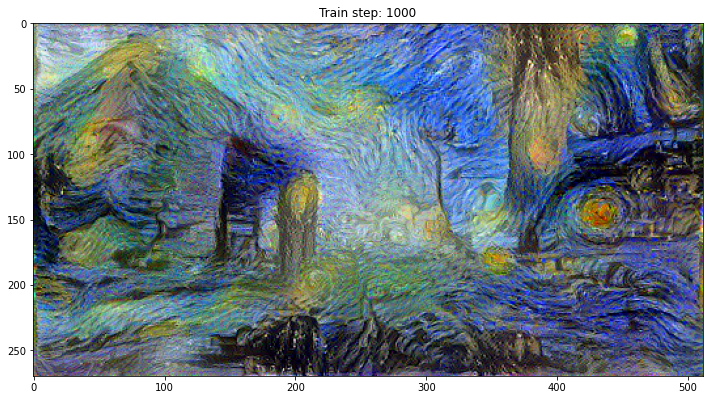

Total time: 0.5


In [ ]:
start = time.time()

epochs = 10
steps_per_epoch = 100

step = 0
for n in range(epochs):
  #print(n)
  for m in range(steps_per_epoch):
      step += 1
      train_step(image)

# Output loss
outputs = extractor(image)
s, c = output_loss(outputs)
style_loss.append(s.numpy())
content_loss.append(c.numpy())

imshow(image.read_value()[0])
plt.title("Train step: {}".format(step))
plt.show()

# file_name = f'./output/style_transfer_nthu_starry_night_content1.png'
file_name = f'/content/drive/MyDrive/Colab Notebooks/output/style_transfer_nthu_starry_night_content1.png'
mpl.image.imsave(file_name, image[0].numpy())

end = time.time()
print("Total time: {:.1f}".format(end-start))

### Loss of different content layers

In [ ]:
style_loss = np.array([11669535.0, 11676170.0, 11597583.0, 11654135.0, 11652564.0]) # 刪
content_loss = np.array([33941.125, 118787.4, 113734.53, 768718.75, 5263.524]) # 刪
print(style_loss)
print(content_loss)

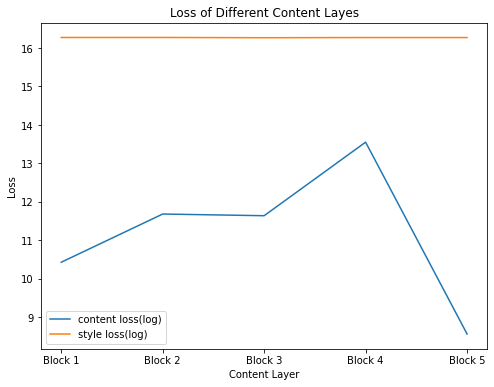

In [ ]:
x = range(1, 6)
values = ['Block 1', 'Block 2', 'Block 3', 'Block 4', 'Block 5']
plt.figure(figsize=(8, 6))
plt.title('Loss of Different Content Layes')
plt.plot(x, np.log(content_loss), label='content loss(log)')
plt.plot(x, np.log(style_loss), label='style loss(log)')
plt.legend(loc='best')
plt.xticks(x, values)
plt.xlabel('Content Layer')
plt.ylabel('Loss')
plt.show()

## Part I Report
First of all, I try to tune three parameters,
<pre>style_weight, content_weight, total_variation_weight</pre>
Actually, the difference between any conbination of weight parameters is too tiny. As the weight of total variation loss increases, the stylized image seems to be slightly smooth. On the other hand, the image loses its content when the style weight increase.<br><br>
When I try to use other content layers, the difference between output images is also small. From the above graph, the content loss using block 5 is the lowest and the error is at least ten times smaller than that of other layers.

# Part II AdaIN

In [3]:
%matplotlib inline

CONTENT_DIRS = ['./dataset/mscoco/test2014']
STYLE_DIRS = ['./dataset/wikiart/test']

# VGG19 was trained by Caffe which converted images from RGB to BGR,
# then zero-centered each color channel with respect to the ImageNet 
# dataset, without scaling.  
IMG_MEANS = np.array([103.939, 116.779, 123.68]) # BGR

IMG_SHAPE = (112, 112, 3)# (224, 224, 3) # training image shape, (h, w, c)
SHUFFLE_BUFFER = 1000
BATCH_SIZE = 16
EPOCHS = 30
STEPS_PER_EPOCH = 12000 // BATCH_SIZE

Sampled content images:


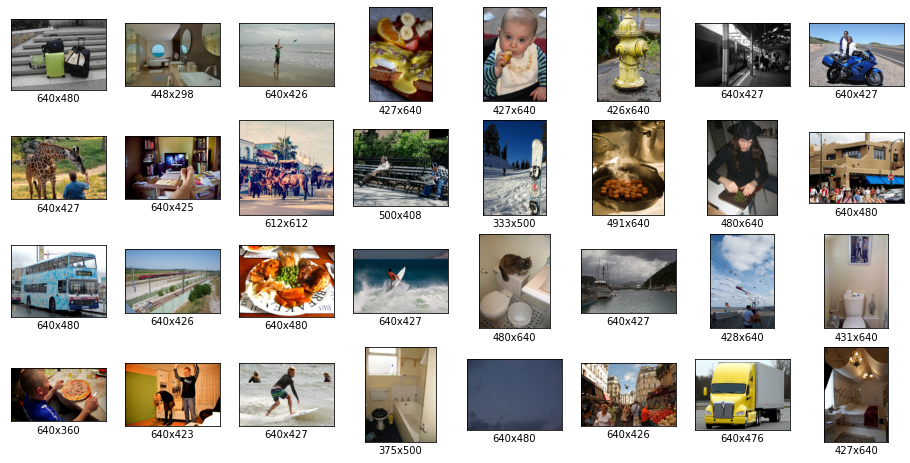

Sampled style images:


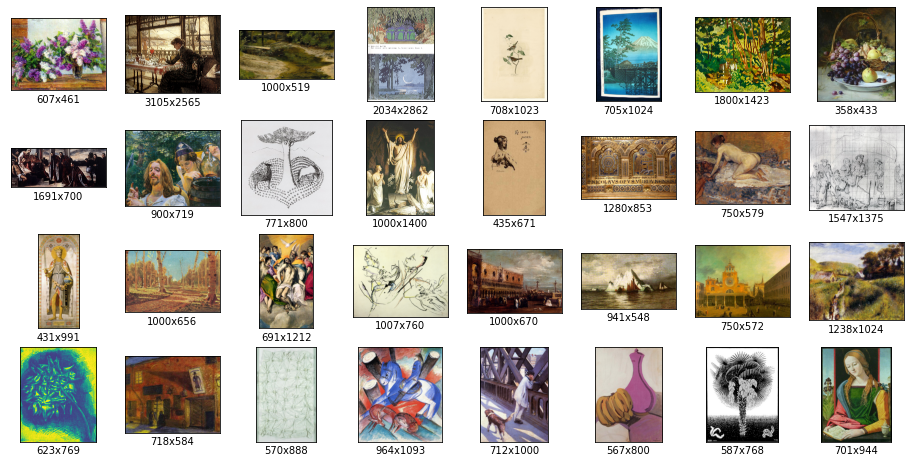

In [7]:
def sample_files(dir, num, pattern='**/*.jpg'):
    '''Samples files in a directory using the reservoir sampling.'''

    paths = Path(dir).glob(pattern) # list of Path objects
    sampled = []
    for i, path in enumerate(paths):
        if i < num:
            sampled.append(path) 
        else:
            s = random.randint(0, i)
            if s < num:
                sampled[s] = path
    return sampled

def plot_images(dir, row, col, pattern):
    paths = sample_files(dir, row*col, pattern)

    plt.figure(figsize=(2*col, 2*row))
    for i in range(row*col):
        im = Image.open(paths[i])
        w, h = im.size

        plt.subplot(row, col, i+1)
        plt.imshow(im)
        plt.grid(False)
        plt.xticks([])
        plt.yticks([])
        plt.xlabel(f'{w}x{h}')
    plt.show()

print('Sampled content images:')
plot_images(CONTENT_DIRS[0], 4, 8, pattern='*.jpg')

print('Sampled style images:')
plot_images(STYLE_DIRS[0], 4, 8, pattern='*.jpg')

## Dataset API

In [8]:
def clean(dir_path, min_shape=None):
    paths = Path(dir_path).glob('**/*.jpg')
    deleted  = 0
    for path in paths:
        try:
            # Make sure we can decode the image
            im = tf.io.read_file(str(path.resolve()))
            im = tf.image.decode_jpeg(im)

            # Remove grayscale images 
            shape = im.shape
            if shape[2] < 3:
                path.unlink()
                deleted += 1

            # Remove small images
            if min_shape is not None:
                if shape[0] < min_shape[0] or shape[1] < min_shape[1]:
                    path.unlink()
                    deleted += 1
        except Exception as e:
            path.unlink()
            deleted += 1
    return deleted

for dir in CONTENT_DIRS:
    deleted = clean(dir)
print(f'#Deleted content images: {deleted}')

for dir in STYLE_DIRS:
    deleted = clean(dir)
print(f'#Deleted style images: {deleted}')

#Deleted content images: 39
#Deleted style images: 232


In [4]:
def preprocess_image(path, init_shape=(448, 448)):
    image = tf.io.read_file(path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, init_shape)
    image = tf.image.random_crop(image, size=IMG_SHAPE)
    image = tf.cast(image, tf.float32)
    
    # Convert image from RGB to BGR, then zero-center each color channel with
    # respect to the ImageNet dataset, without scaling.
    image = image[..., ::-1] # RGB to BGR
    image -= (103.939, 116.779, 123.68) # BGR means
    return image

def np_image(image):
    image += (103.939, 116.779, 123.68) # BGR means
    image = image[..., ::-1] # BGR to RGB
    image = tf.clip_by_value(image, 0, 255)
    image = tf.cast(image, dtype='uint8')
    return image.numpy()

def build_dataset(num_gpus=1):
    c_paths = []
    for c_dir in CONTENT_DIRS:
        c_paths += Path(c_dir).glob('*.jpg')
    c_paths = [str(path.resolve()) for path in c_paths]
    s_paths = []
    for s_dir in STYLE_DIRS:
        s_paths += Path(s_dir).glob('*.jpg')
    s_paths = [str(path.resolve()) for path in s_paths]
    print(f'Building dataset from {len(c_paths):,} content images and {len(s_paths):,} style images... ', end='')

    AUTOTUNE = tf.data.experimental.AUTOTUNE

    c_ds = tf.data.Dataset.from_tensor_slices(c_paths)
    c_ds = c_ds.map(preprocess_image, num_parallel_calls=AUTOTUNE)
    c_ds = c_ds.repeat()
    c_ds = c_ds.shuffle(buffer_size=SHUFFLE_BUFFER)

    s_ds = tf.data.Dataset.from_tensor_slices(s_paths)
    s_ds = s_ds.map(preprocess_image, num_parallel_calls=AUTOTUNE)
    s_ds = s_ds.repeat()
    s_ds = s_ds.shuffle(buffer_size=SHUFFLE_BUFFER)

    ds = tf.data.Dataset.zip((c_ds, s_ds))
    ds = ds.batch(BATCH_SIZE * num_gpus)
    ds = ds.prefetch(buffer_size=AUTOTUNE)

    print('done')
    return ds

Building dataset from 40,736 content images and 23,585 style images... done
Content batch shape: (32, 224, 224, 3)
Style batch shape: (32, 224, 224, 3)


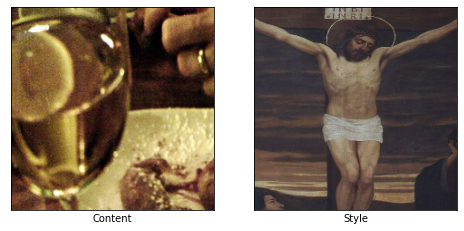

In [10]:
ds = build_dataset()
c_batch, s_batch = next(iter(ds.take(1)))

print('Content batch shape:', c_batch.shape)
print('Style batch shape:', s_batch.shape)

plt.figure(figsize=(8, 4))

plt.subplot(1, 2, 1)
plt.imshow(np_image(c_batch[0]))
plt.grid(False)
plt.xticks([])
plt.yticks([])
plt.xlabel('Content')

plt.subplot(1, 2, 2)
plt.imshow(np_image(s_batch[0]))
plt.grid(False)
plt.xticks([])
plt.yticks([])
plt.xlabel('Style')

plt.show()

## Adaptive Instance Normalization

In [47]:
class AdaIN(tf.keras.layers.Layer):
    # Normalized_c, epsilon
    def __init__(self, name='AdaIN', epsilon=1e-5):
        super(AdaIN, self).__init__(name)
        # self.name = name
        self.epsilon = epsilon
    
    def call(self, inputs):
        content = inputs[0]
        style = inputs[1]
        # c_mean, c_var = tf.nn.moments(c_enc, axes=(1,2), keepdims=True)
        # s_mean, s_var = tf.nn.moments(s_enc, axes=(1,2), keepdims=True)

        c_var = tf.math.add(tf.math.reduce_std(content, axis=[1,2], keepdims=True), self.epsilon)
        s_var = tf.math.add(tf.math.reduce_std(style, axis=[1,2], keepdims=True), self.epsilon)
        
        c_mean = tf.math.reduce_mean(content, axis=[1,2], keepdims=True)
        s_mean = tf.math.reduce_mean(style, axis=[1,2], keepdims=True) 

        normalized_c = tf.divide(tf.subtract(content, c_mean), c_var)
        normalized_c = tf.add(tf.multiply(s_var, normalized_c), s_mean)

        return normalized_c

## Model

In [48]:
class ArbitraryStyleTransferNet(tf.keras.Model):
    CONTENT_LAYER = 'block4_conv1'
    STYLE_LAYERS = ('block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1')

    @staticmethod
    def declare_decoder():
        # a_input = tf.keras.Input(shape=(28, 28, 512), name='input_adain')\
        a_input = tf.keras.Input(shape=(14, 14, 512), name='input_adain')

        h = tf.keras.layers.Conv2DTranspose(256, 3, padding='same', activation='relu')(a_input)
        h = tf.keras.layers.UpSampling2D(2)(h)
        h = tf.keras.layers.Conv2DTranspose(256, 3, padding='same', activation='relu')(h)
        h = tf.keras.layers.Conv2DTranspose(256, 3, padding='same', activation='relu')(h)
        h = tf.keras.layers.Conv2DTranspose(256, 3, padding='same', activation='relu')(h)
        h = tf.keras.layers.Conv2DTranspose(128, 3, padding='same', activation='relu')(h)
        h = tf.keras.layers.UpSampling2D(2)(h)
        h = tf.keras.layers.Conv2DTranspose(128, 3, padding='same', activation='relu')(h)
        h = tf.keras.layers.Conv2DTranspose(64, 3, padding='same', activation='relu')(h)
        h = tf.keras.layers.UpSampling2D(2)(h)
        h = tf.keras.layers.Conv2DTranspose(64, 3, padding='same', activation='relu')(h)
        output = tf.keras.layers.Conv2DTranspose(3, 3, padding='same')(h)

        return tf.keras.Model(inputs=a_input, outputs=output, name='decoder')
  
    def __init__(self,
                 img_shape=IMG_SHAPE, # (224, 224, 3),
                 content_loss_weight=1,
                 style_loss_weight=10,
                 name='arbitrary_style_transfer_net',
                 **kwargs):
        super(ArbitraryStyleTransferNet, self).__init__(name=name, **kwargs)

        self.img_shape = img_shape
        self.content_loss_weight = content_loss_weight
        self.style_loss_weight = style_loss_weight
        
        vgg19 = tf.keras.applications.VGG19(include_top=False, weights='imagenet', input_shape=img_shape)
        vgg19.trainable = False

        c_output = [vgg19.get_layer(ArbitraryStyleTransferNet.CONTENT_LAYER).output]
        s_outputs = [vgg19.get_layer(name).output for name in ArbitraryStyleTransferNet.STYLE_LAYERS]
        self.vgg19 = tf.keras.Model(inputs=vgg19.input, outputs=c_output+s_outputs, name='vgg19')
        self.vgg19.trainable = False

        self.adain = AdaIN(name='adain')
        self.decoder = ArbitraryStyleTransferNet.declare_decoder()
  
    def call(self, inputs):
        c_batch, s_batch = inputs

        c_enc = self.vgg19(c_batch)
        c_enc_c = c_enc[0]

        s_enc = self.vgg19(s_batch)
        s_enc_c = s_enc[0]
        s_enc_s = s_enc[1:] 
        
        # normalized_c is the output of AdaIN layer
        normalized_c = self.adain((c_enc_c, s_enc_c))
        output = self.decoder(normalized_c)

        # Calculate loss
        out_enc = self.vgg19(output)
        out_enc_c = out_enc[0]
        out_enc_s = out_enc[1:]
        
        # out_enc_c = tf.where(tf.math.is_nan(out_enc_c), tf.zeros_like(out_enc_c), out_enc_c)
        # normalized_c = tf.where(tf.math.is_nan(normalized_c), tf.zeros_like(normalized_c), normalized_c)

        loss_c = tf.reduce_mean(tf.math.squared_difference(out_enc_c, normalized_c))
        # tmp = tf.math.squared_difference(out_enc_c, normalized_c)
        # loss_c = tf.reduce_mean(tf.boolean_mask(tmp, tf.math.is_finite(tmp)))
        # print(loss_c)
        
        self.add_loss(self.content_loss_weight * loss_c)
        
        loss_s = 0
        for o, s in zip(out_enc_s, s_enc_s):    
            o_mean, o_var = tf.nn.moments(o, axes=(1,2), keepdims=True)
            o_std = tf.sqrt(o_var + self.adain.epsilon)

            s_mean, s_var = tf.nn.moments(s, axes=(1,2), keepdims=True)
            s_std = tf.sqrt(s_var + self.adain.epsilon)

            loss_mean = tf.reduce_mean(tf.math.squared_difference(o_mean, s_mean))
            loss_std = tf.reduce_mean(tf.math.squared_difference(o_std, s_std))

            loss_s += loss_mean + loss_std
        self.add_loss(self.style_loss_weight * loss_s)

        return output, c_enc_c, normalized_c, out_enc_c

In [7]:
# Plot results
def plot_outputs(outputs, captions=None, col=5):
    row = len(outputs)
    plt.figure(figsize=(3*col, 3*row))
    for i in range(col):
        for j in range(row):
            plt.subplot(row, col, j*col+i+1)
            plt.imshow(np_image(outputs[j][i,...,:3]))
            plt.grid(False)
            plt.xticks([])
            plt.yticks([])
            if captions is not None:
                plt.xlabel(captions[j])
    plt.show()

In [49]:
ds = build_dataset()
model = ArbitraryStyleTransferNet(img_shape=IMG_SHAPE)

c_batch, s_batch = next(iter(ds.take(1)))
print(f'Input shape: ({c_batch.shape}, {s_batch.shape})')
output, *_ = model((c_batch, s_batch))
print(f'Output shape: {output.shape}')
print(f'Init. content loss: {model.losses[0]:,.2f}, style loss: {model.losses[1]:,.2f}')
model.summary()

Building dataset from 40,736 content images and 23,585 style images... done
Input shape: ((16, 112, 112, 3), (16, 112, 112, 3))
Output shape: (16, 112, 112, 3)
Init. content loss: 1,987,405.38, style loss: 11,710,464.00
Model: "arbitrary_style_transfer_net"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
vgg19 (Functional)           [(None, 14, 14, 512), (No 3505728   
_________________________________________________________________
ada_in_12 (AdaIN)            multiple                  0         
_________________________________________________________________
decoder (Functional)         (None, 112, 112, 3)       3505219   
Total params: 7,010,947
Trainable params: 3,505,219
Non-trainable params: 3,505,728
_________________________________________________________________


## Training

In [50]:
# Train the model
optimizer = tf.keras.optimizers.Adam(learning_rate=5e-4)
c_loss_metric, s_loss_metric = tf.keras.metrics.Mean(), tf.keras.metrics.Mean()

CKP_DIR = 'checkpoints'
init_epoch = 1

ckp = tf.train.latest_checkpoint(CKP_DIR)
if ckp:
    model.load_weights(ckp)
    init_epoch = int(ckp.split('_')[-1]) + 1
    print(f'Resume training from epoch {init_epoch-1}')

In [51]:
@tf.function
def train_step(inputs):
    with tf.GradientTape() as tape:
        model(inputs)
        c_loss, s_loss = model.losses
        loss = c_loss + s_loss
    grads = tape.gradient(loss, model.trainable_variables)
    optimizer.apply_gradients(zip(grads, model.trainable_variables))

    c_loss_metric(c_loss)
    s_loss_metric(s_loss)

In [52]:
def train(dataset, init_epoch):
    for epoch in range(init_epoch, EPOCHS+1):
        print(f'Epoch {epoch:>2}/{EPOCHS}')
        for step, inputs in enumerate(ds.take(STEPS_PER_EPOCH)):
            train_step(inputs)
            print(f'\r{step+1:>5}/{STEPS_PER_EPOCH} - loss: {c_loss_metric.result()+s_loss_metric.result():,.2f} - content loss: {c_loss_metric.result():,.2f} - style loss: {s_loss_metric.result():,.2f}', end='') 

        print()
        model.save_weights(os.path.join(CKP_DIR, f'ckpt_{epoch}'))
        c_loss_metric.reset_states()
        s_loss_metric.reset_states()

        output, c_enc_c, normalized_c, out_enc_c = model((c_batch, s_batch))
        plot_outputs((s_batch, c_batch, output, c_enc_c, normalized_c, out_enc_c), 
                     ('Style', 'Content', 'Trans', 'Content Enc', 'Normalized', 'Trans Enc'))

Epoch  1/30
  750/750 - loss: 2,128,028.00 - content loss: 618,491.88 - style loss: 1,509,536.12


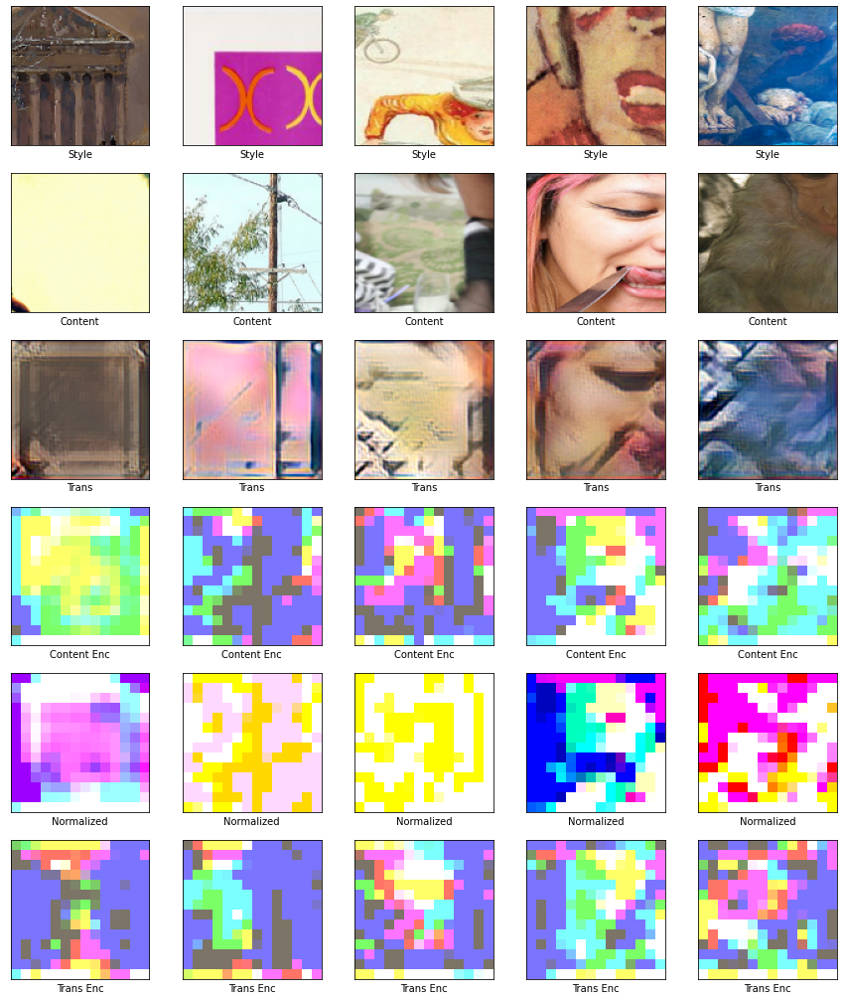

Epoch  2/30
  750/750 - loss: 1,299,617.12 - content loss: 485,170.22 - style loss: 814,446.94


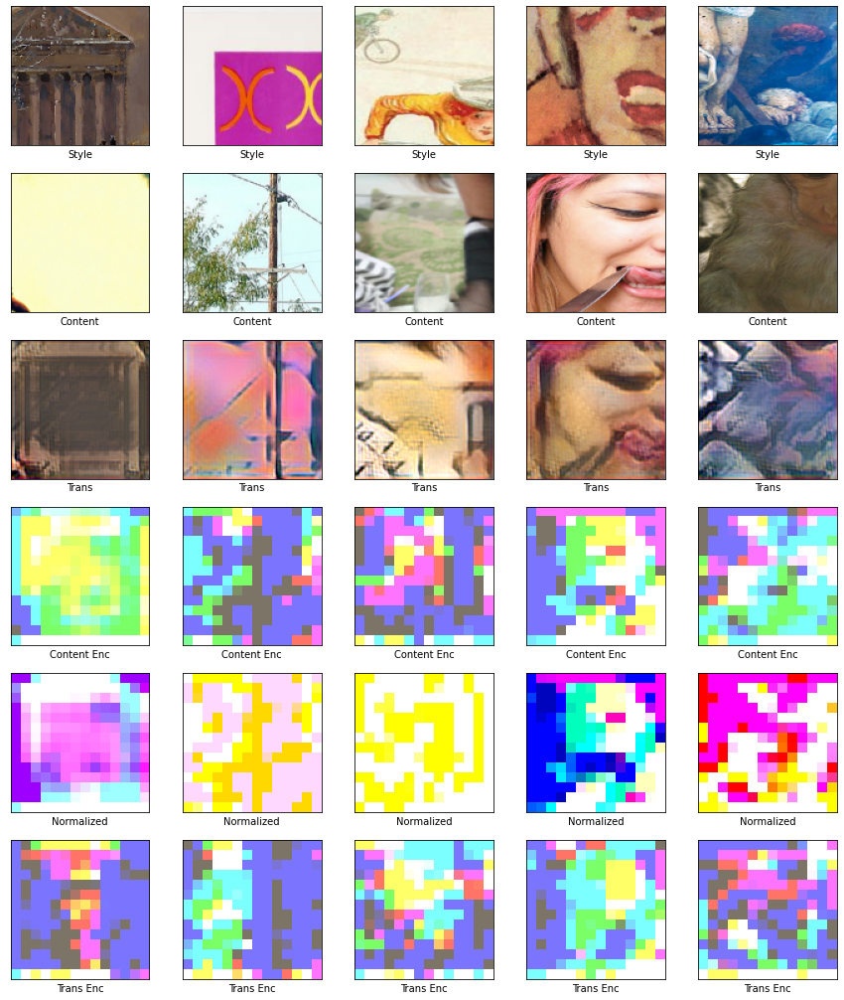

Epoch  3/30
  750/750 - loss: 1,172,757.88 - content loss: 449,468.28 - style loss: 723,289.62


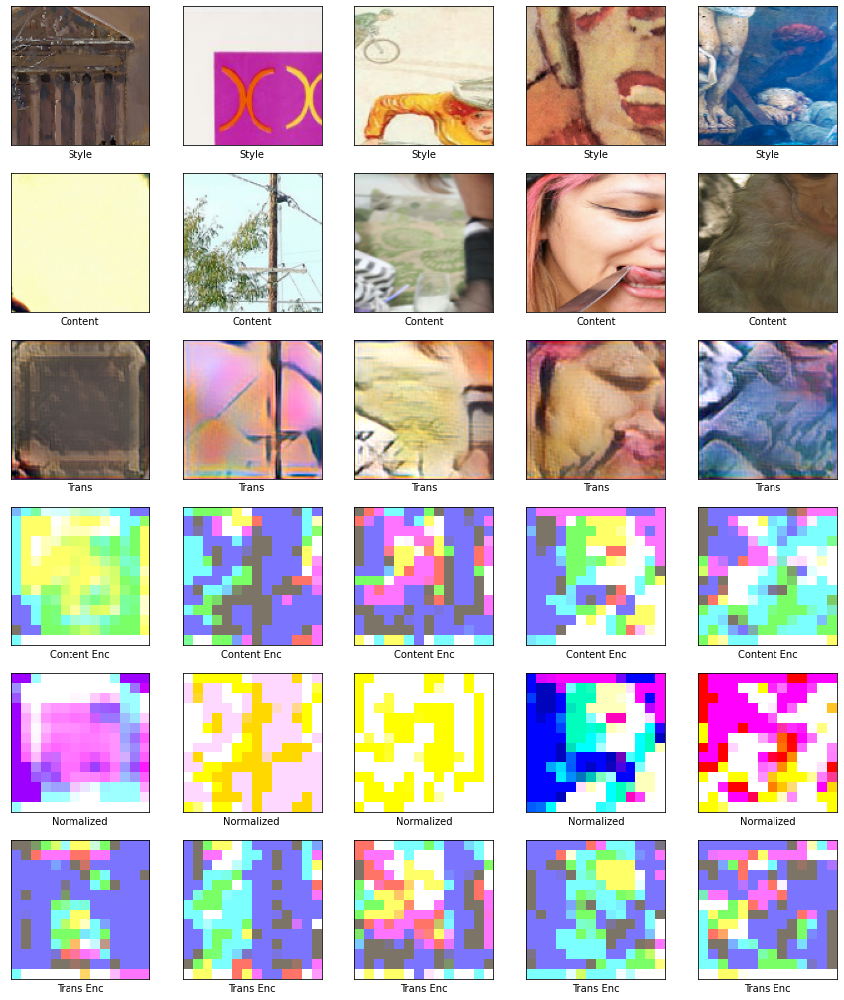

Epoch  4/30
  750/750 - loss: 1,082,516.88 - content loss: 423,985.84 - style loss: 658,531.00


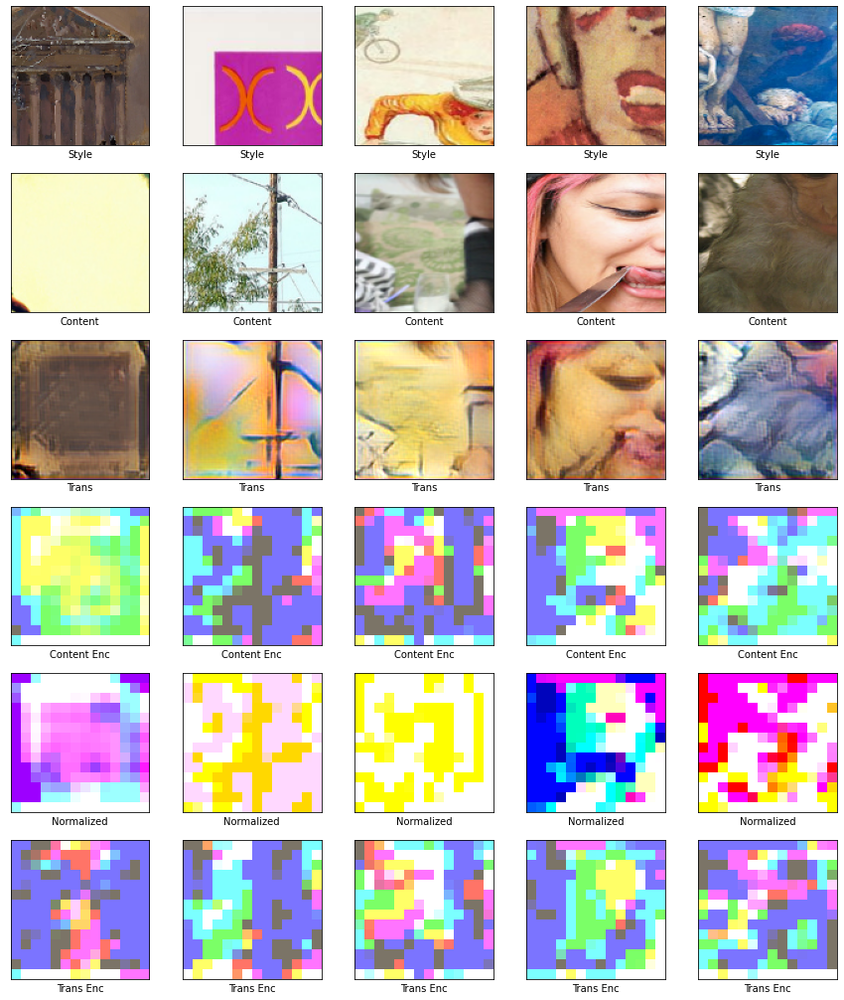

Epoch  5/30
  750/750 - loss: 1,062,485.50 - content loss: 412,220.47 - style loss: 650,265.06


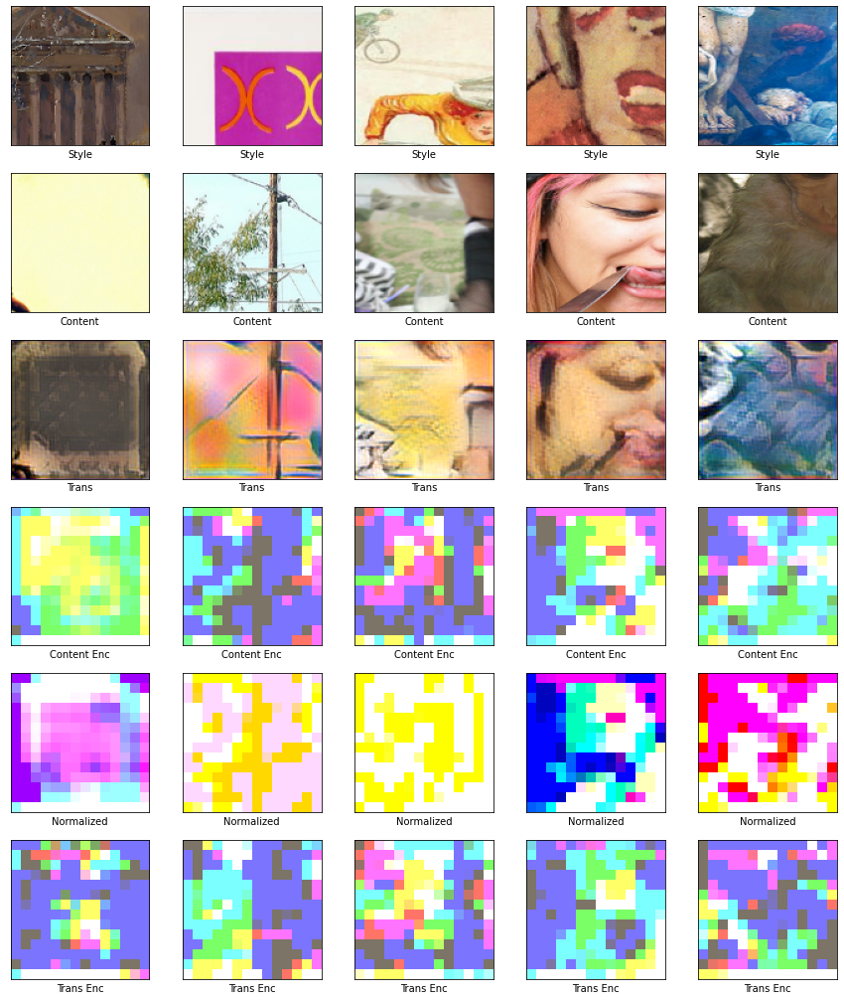

Epoch  6/30
  750/750 - loss: 995,134.56 - content loss: 395,626.94 - style loss: 599,507.62


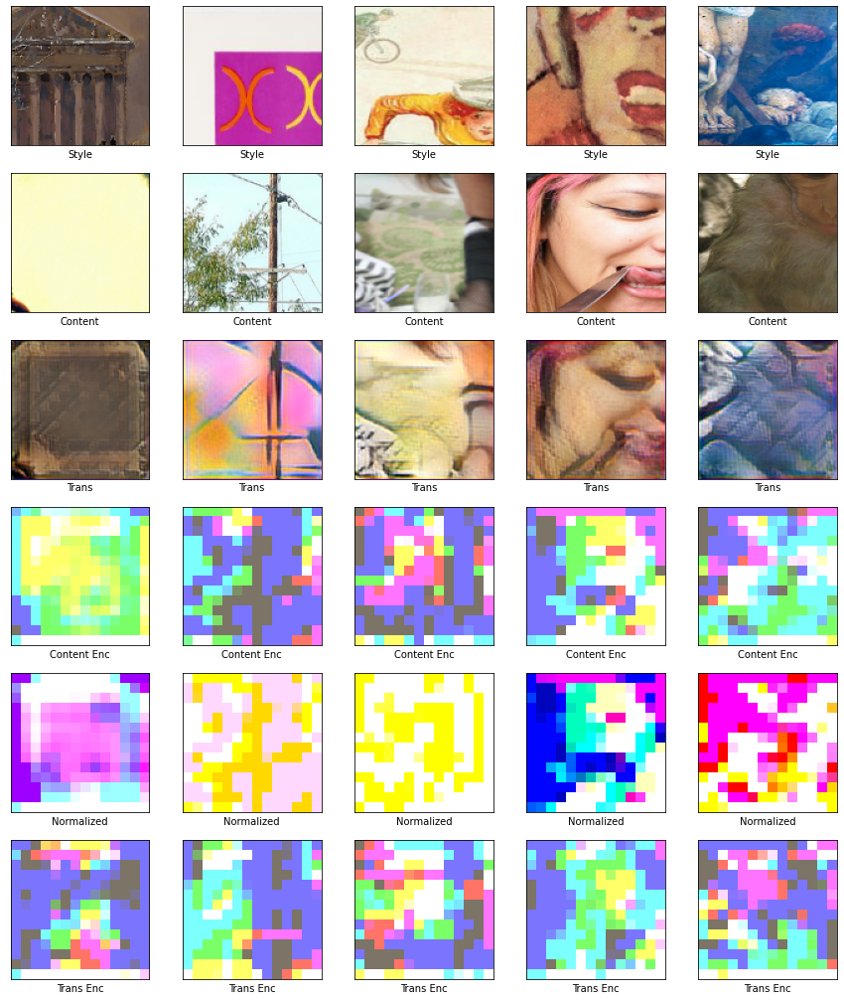

Epoch  7/30
  750/750 - loss: 979,860.00 - content loss: 389,286.69 - style loss: 590,573.31


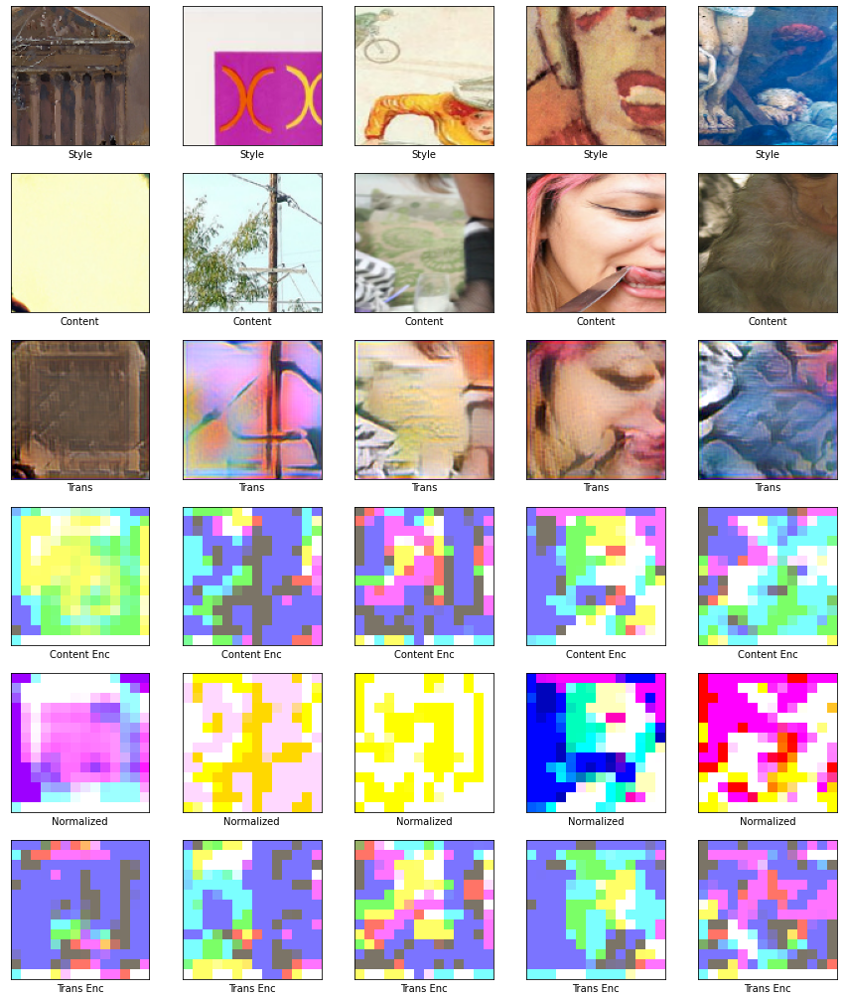

Epoch  8/30
  750/750 - loss: 978,637.75 - content loss: 387,004.34 - style loss: 591,633.44


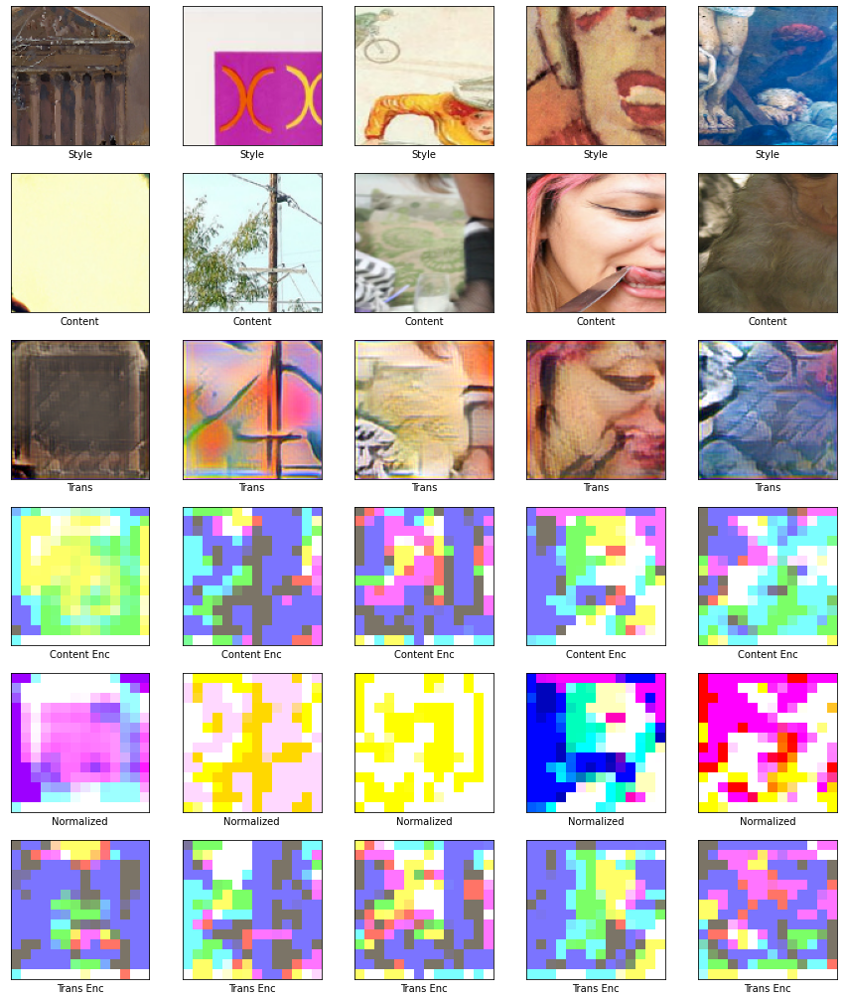

Epoch  9/30
  750/750 - loss: 936,895.38 - content loss: 376,835.53 - style loss: 560,059.88


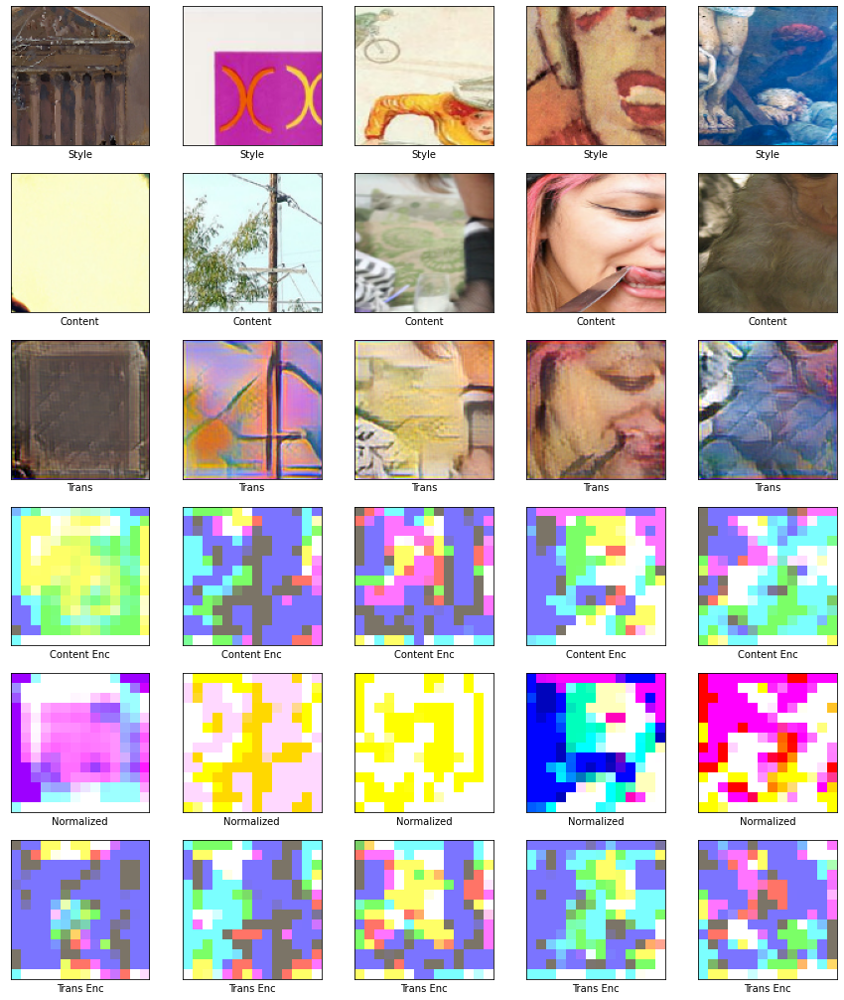

Epoch 10/30
  750/750 - loss: 922,207.69 - content loss: 373,501.94 - style loss: 548,705.75


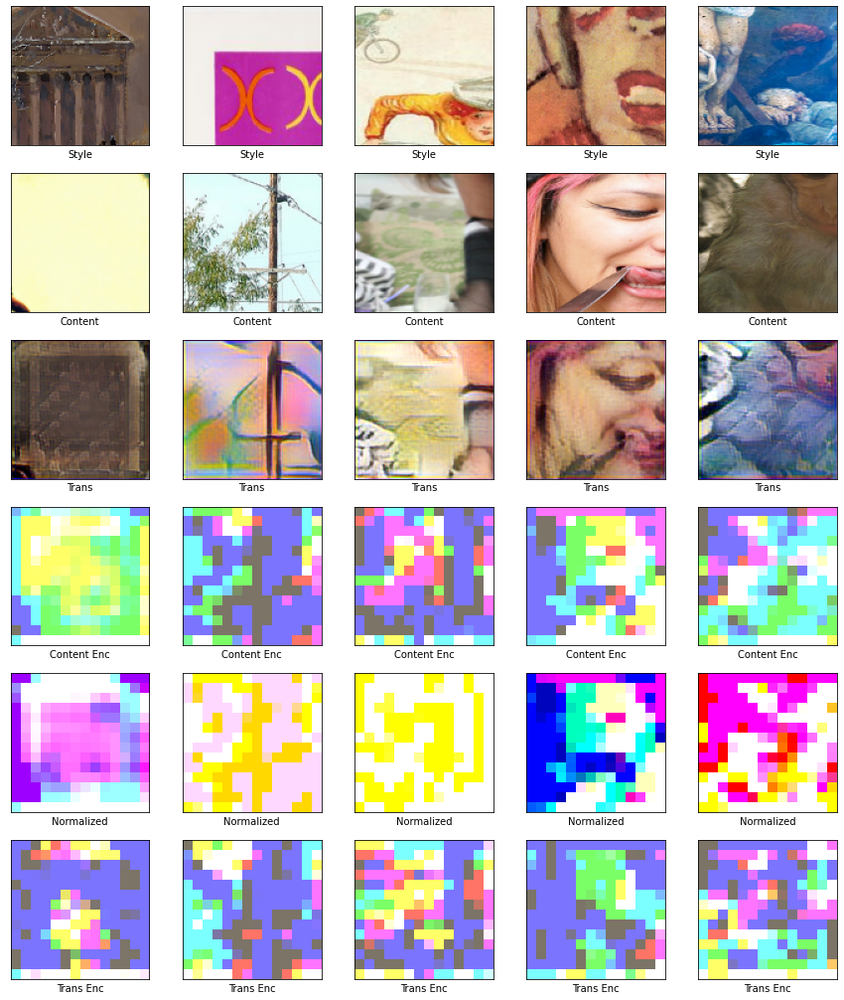

Epoch 11/30
  750/750 - loss: 918,206.31 - content loss: 369,164.19 - style loss: 549,042.12


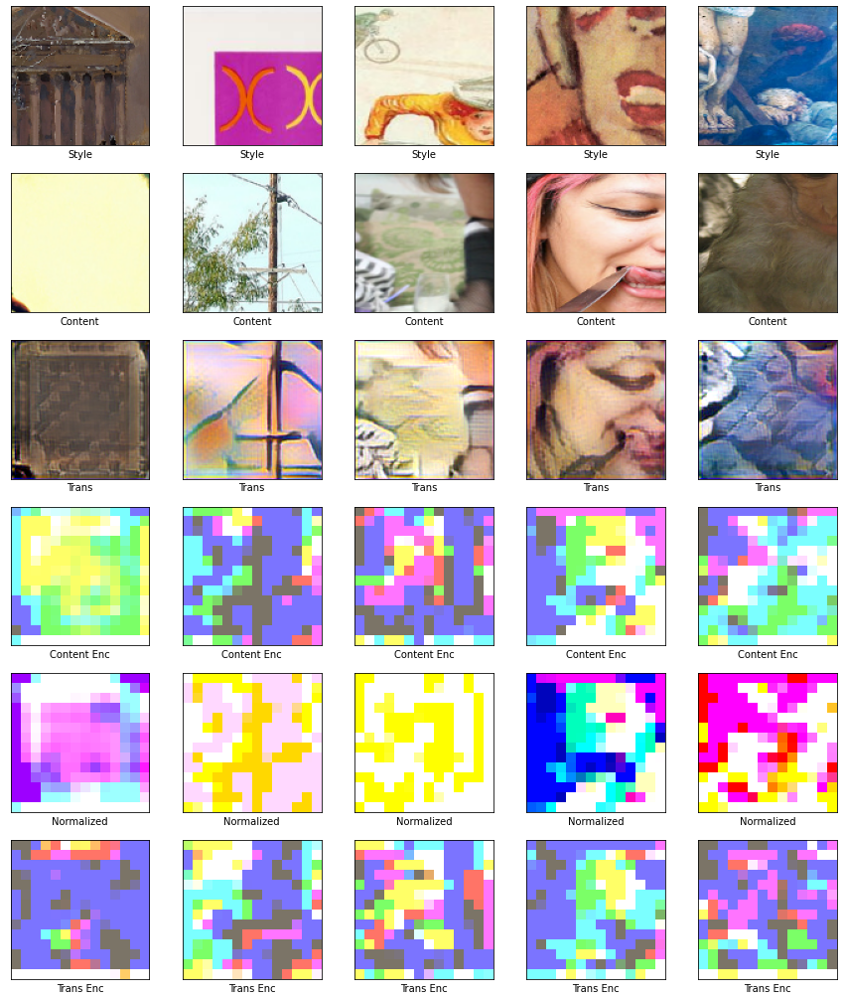

Epoch 12/30
  750/750 - loss: 898,396.75 - content loss: 364,401.09 - style loss: 533,995.62


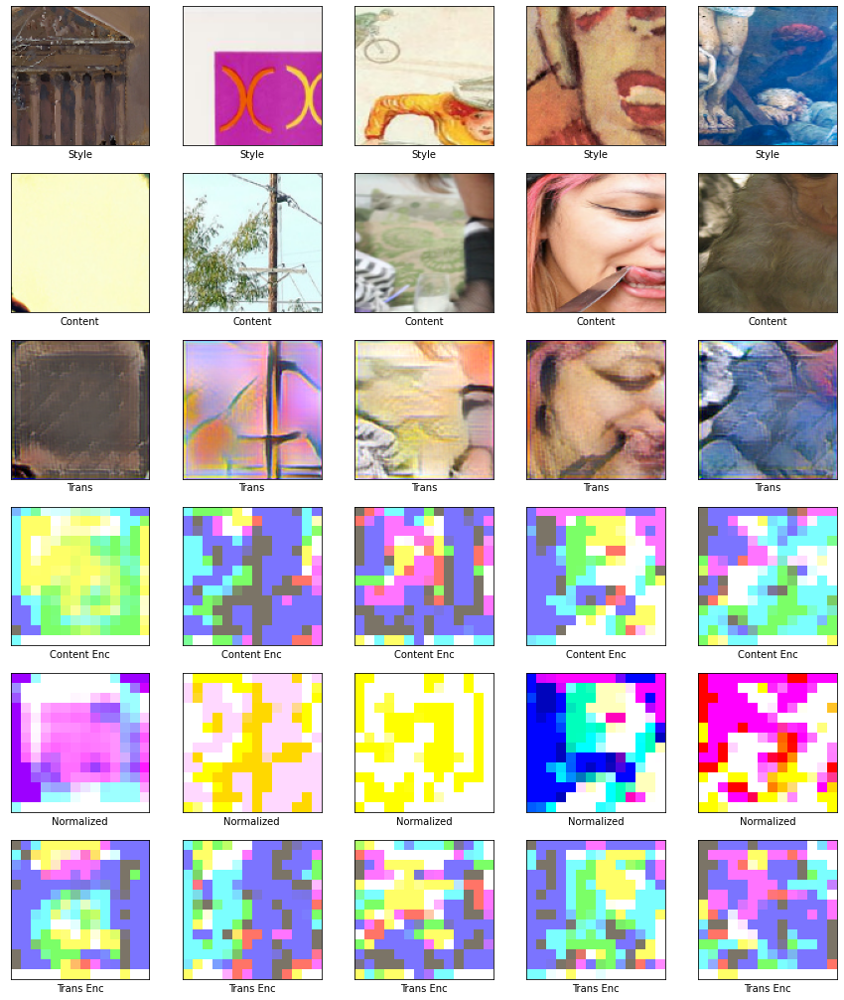

Epoch 13/30
  750/750 - loss: 894,712.44 - content loss: 362,559.38 - style loss: 532,153.06


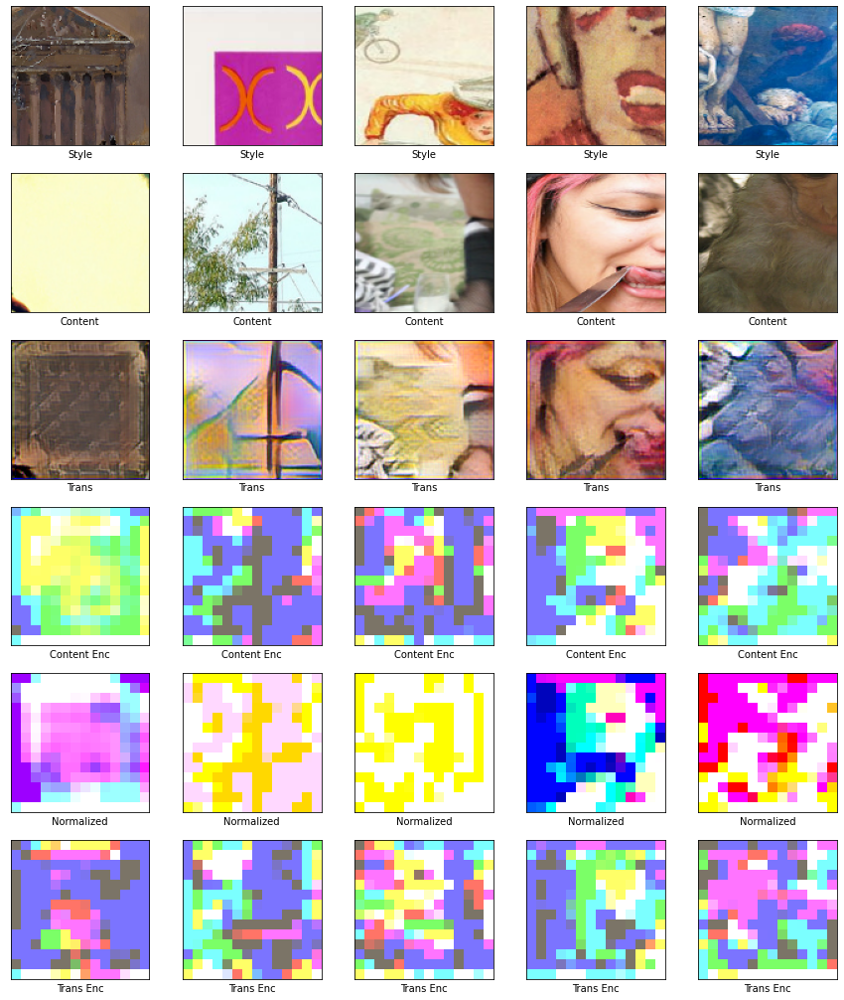

Epoch 14/30
  750/750 - loss: 884,995.62 - content loss: 359,258.66 - style loss: 525,736.94


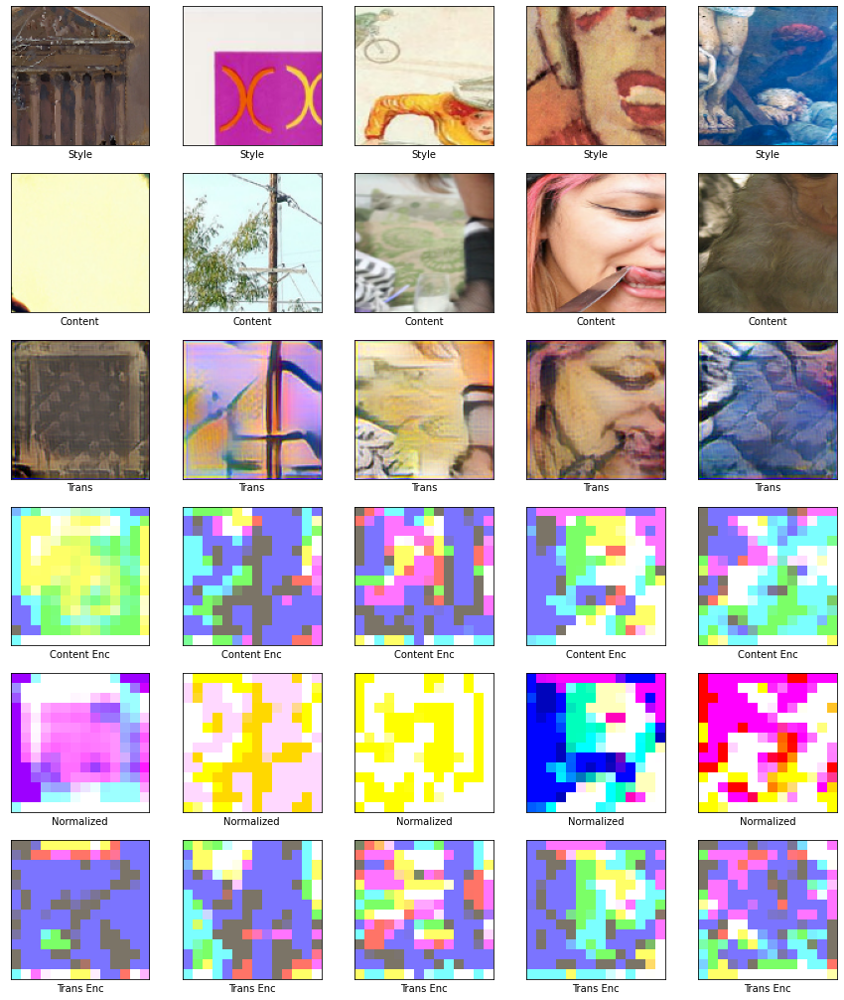

Epoch 15/30
  750/750 - loss: 865,888.75 - content loss: 354,806.00 - style loss: 511,082.78


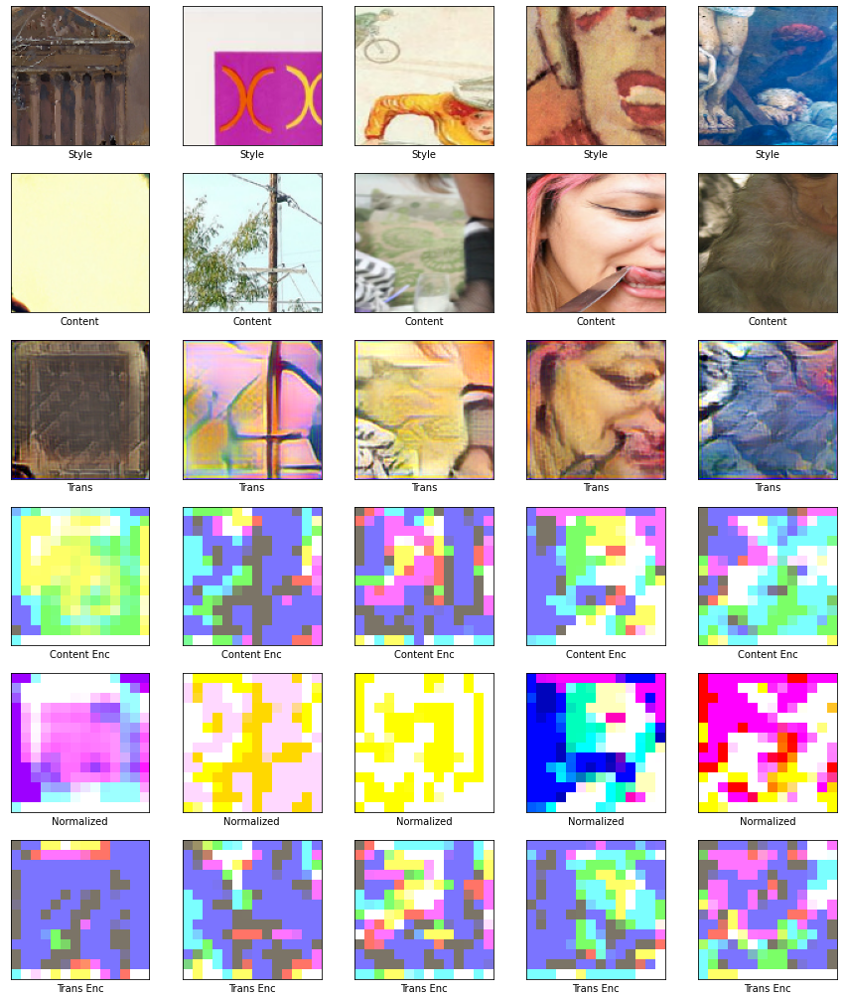

Epoch 16/30
  750/750 - loss: 841,044.62 - content loss: 351,463.84 - style loss: 489,580.75


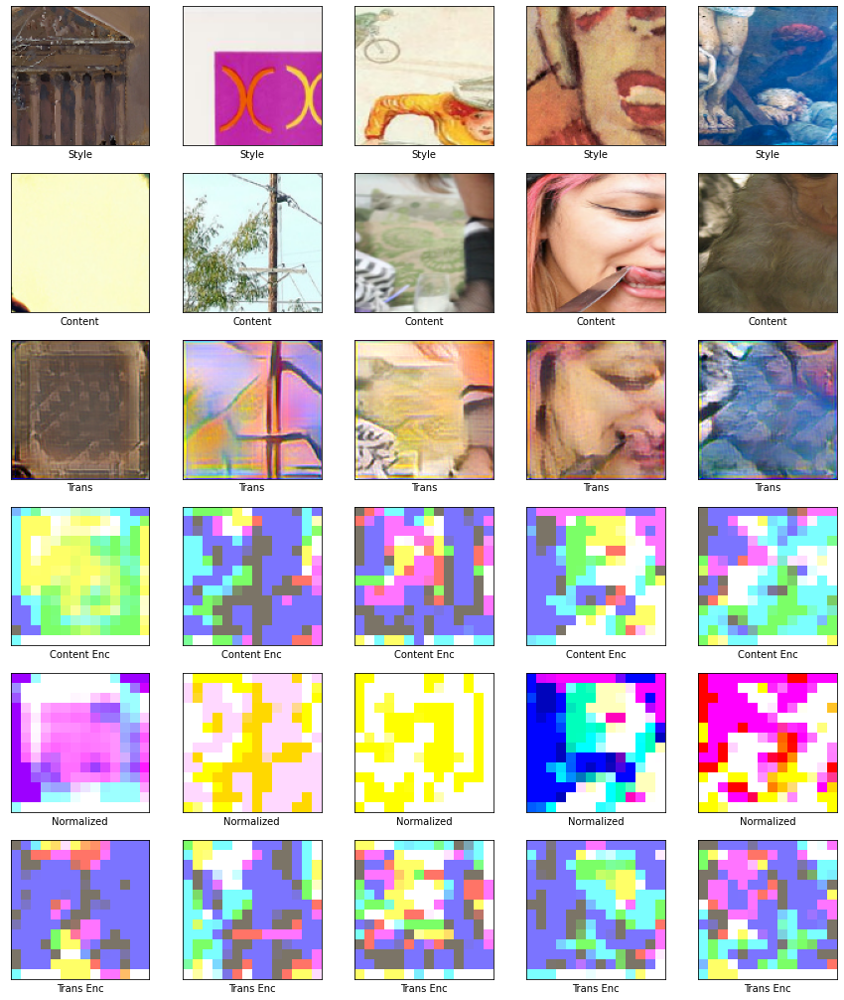

Epoch 17/30
  750/750 - loss: 851,281.88 - content loss: 351,049.50 - style loss: 500,232.38


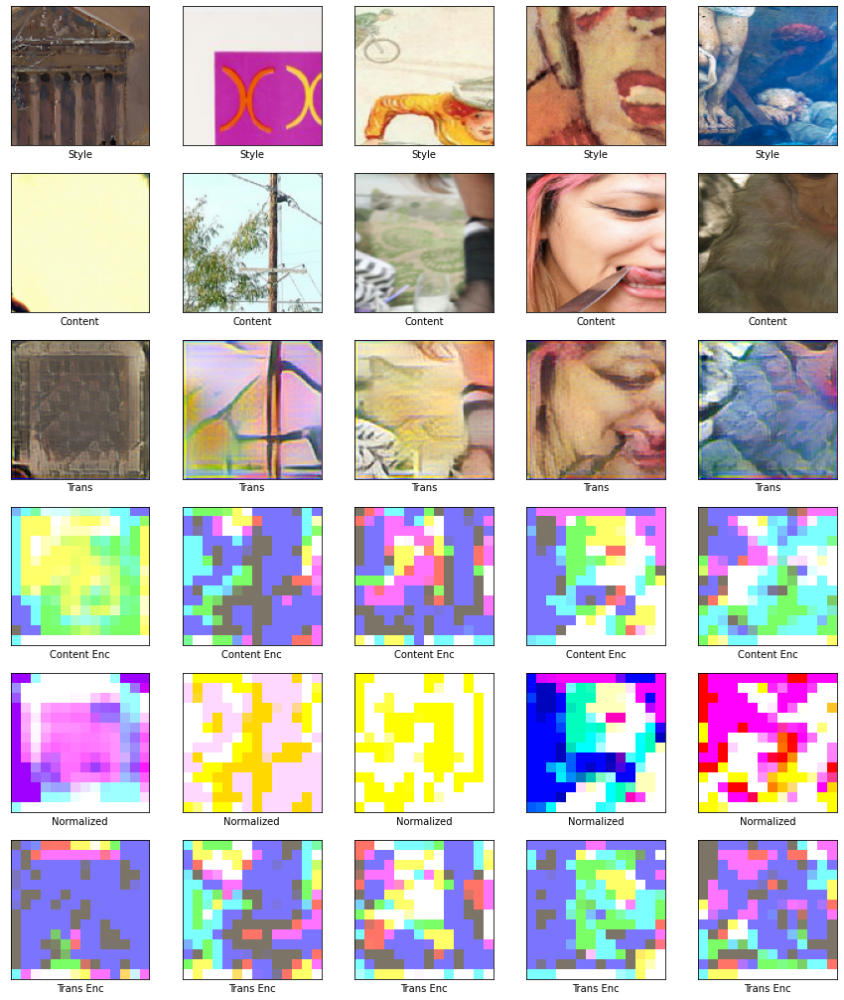

Epoch 18/30
  750/750 - loss: 832,472.75 - content loss: 344,774.62 - style loss: 487,698.09


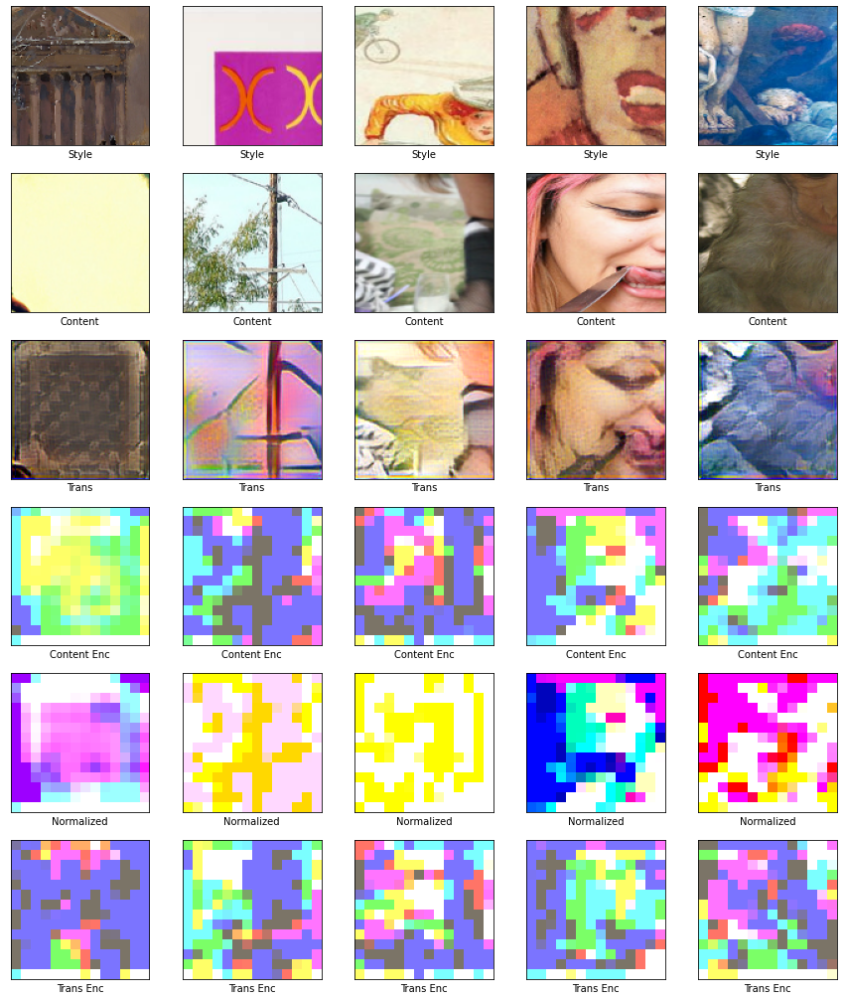

Epoch 19/30
  750/750 - loss: 827,029.44 - content loss: 342,838.12 - style loss: 484,191.31


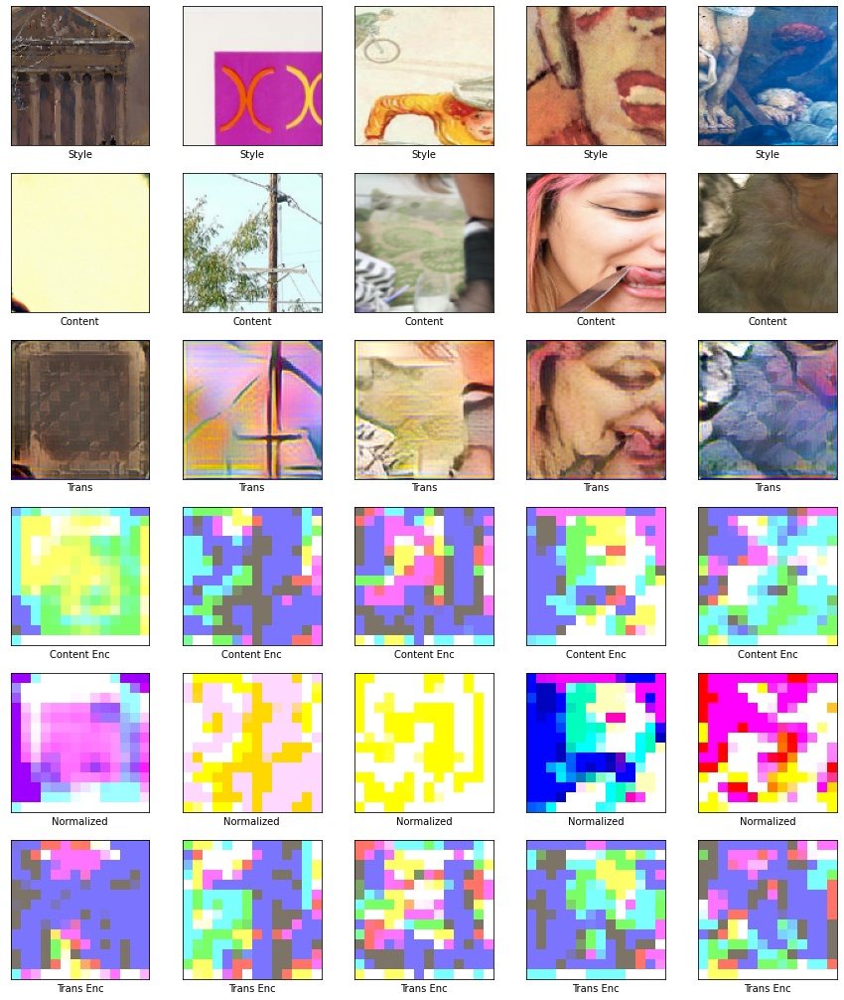

Epoch 20/30
  750/750 - loss: 824,559.62 - content loss: 341,574.12 - style loss: 482,985.50


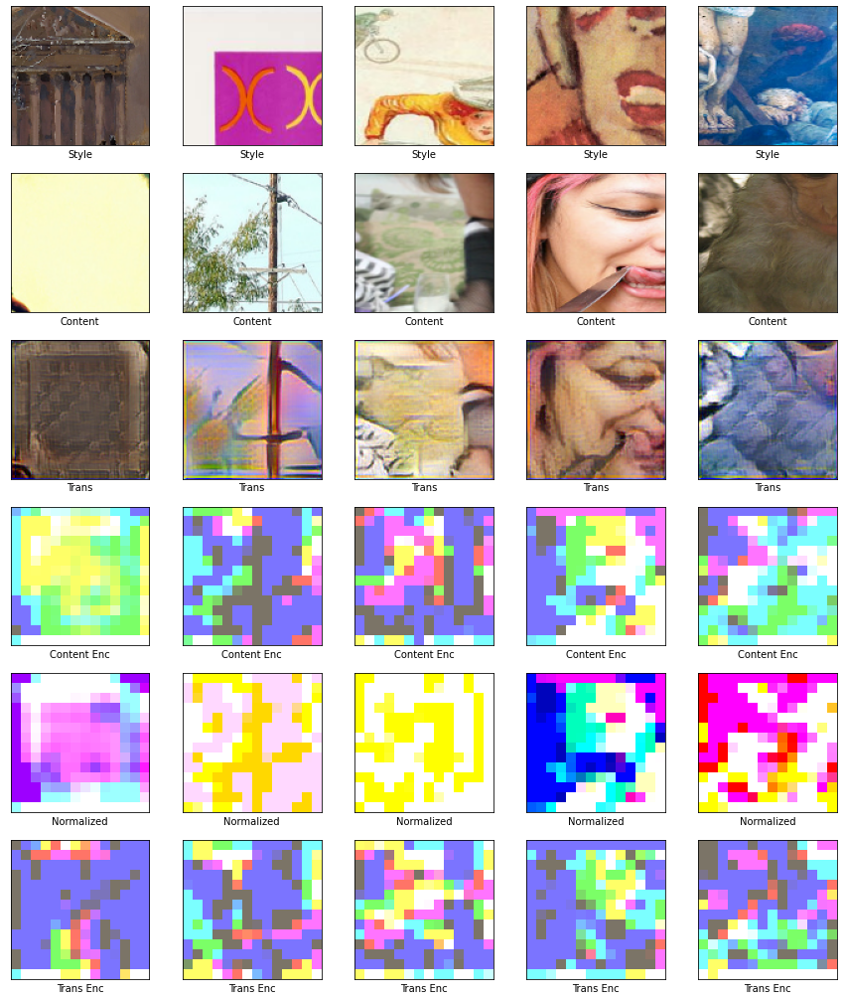

Epoch 21/30
  750/750 - loss: 809,186.25 - content loss: 338,053.47 - style loss: 471,132.81


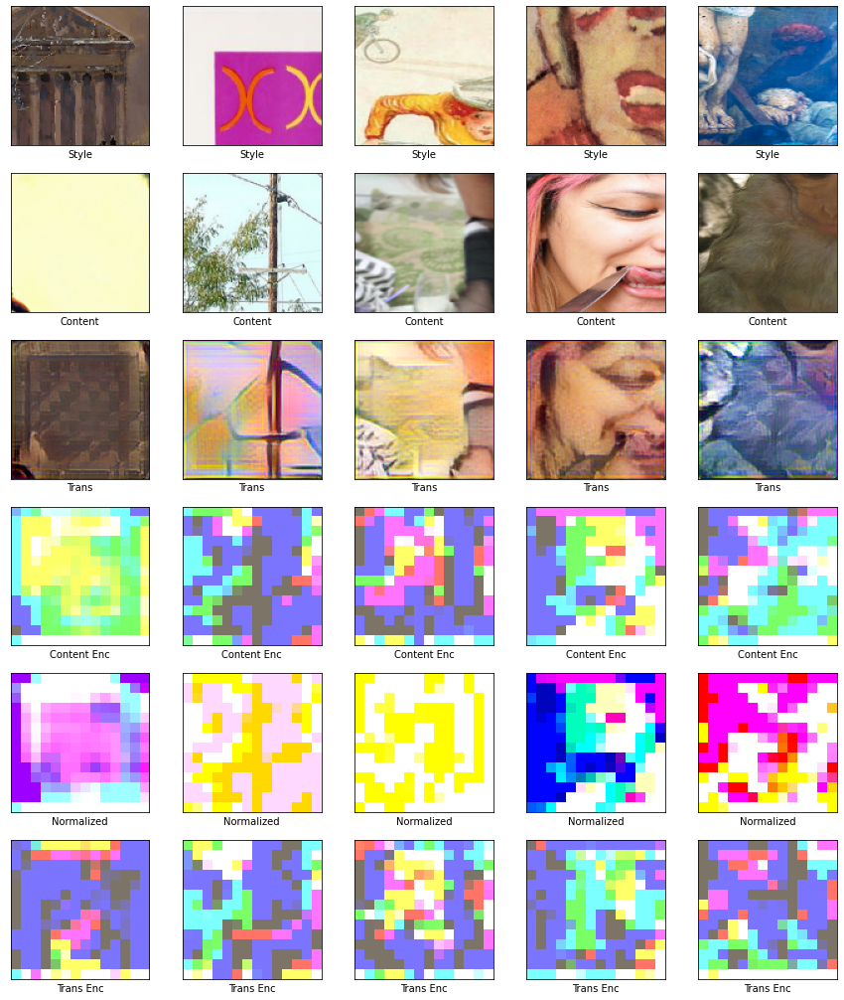

Epoch 22/30
  750/750 - loss: 813,761.25 - content loss: 338,151.84 - style loss: 475,609.44


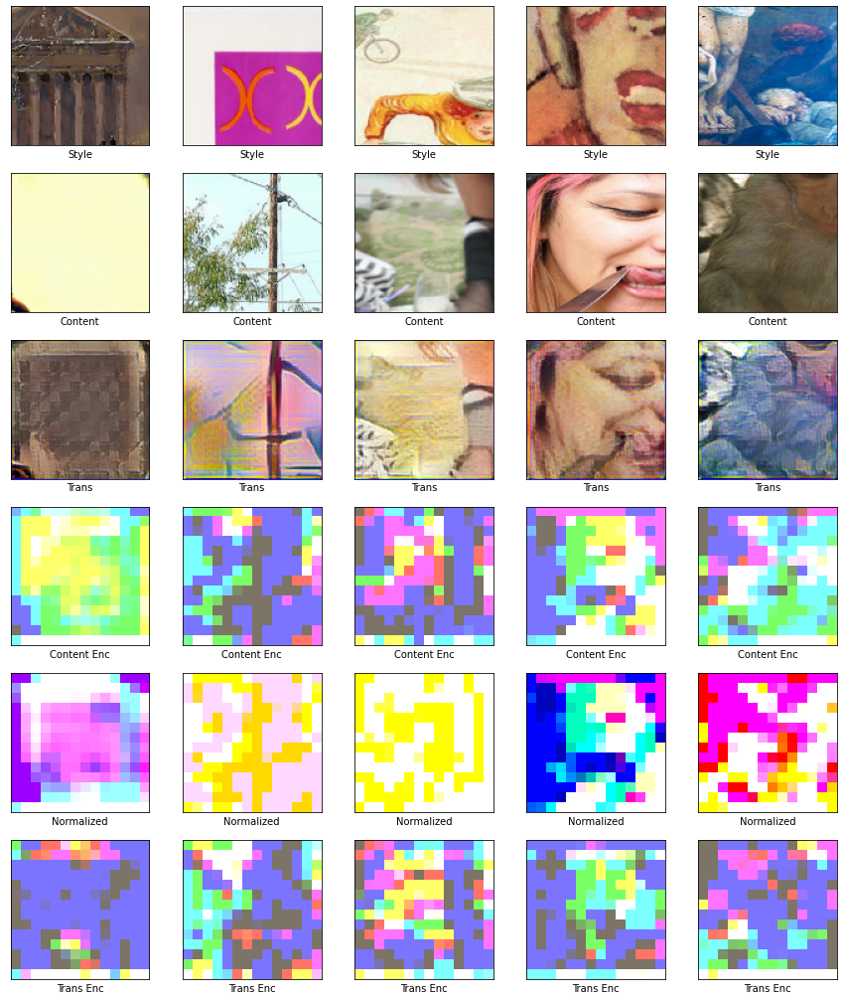

Epoch 23/30
  750/750 - loss: 807,972.12 - content loss: 336,133.59 - style loss: 471,838.50


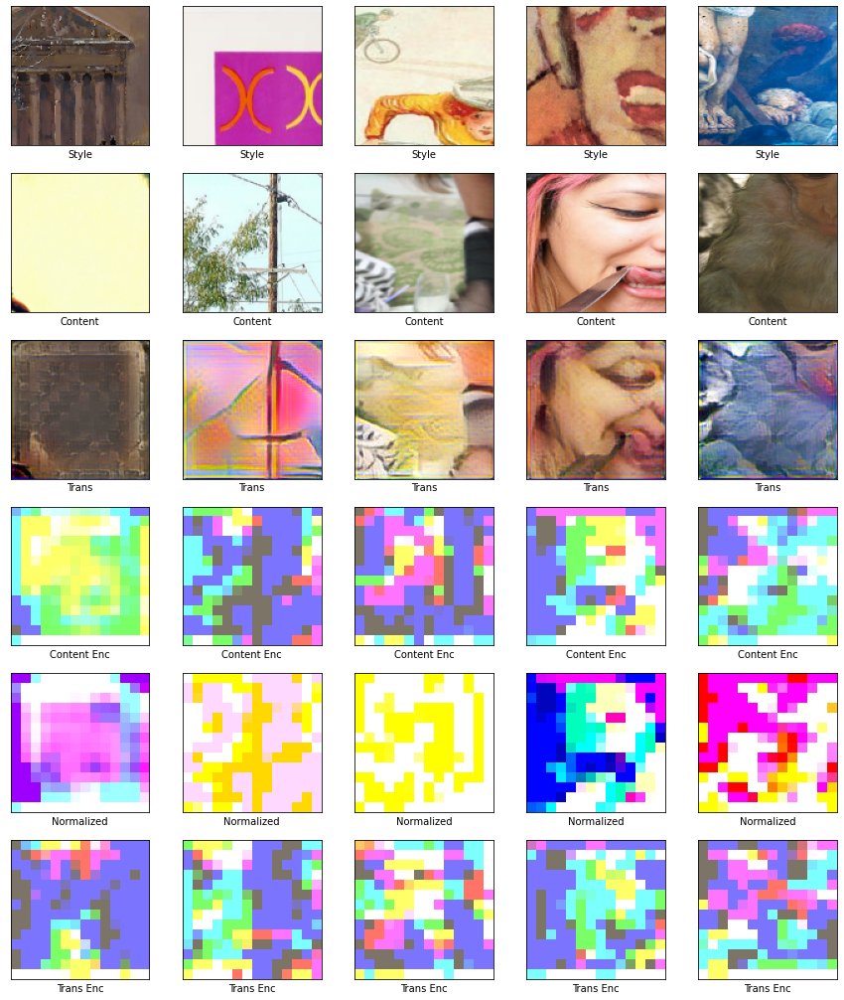

Epoch 24/30
  750/750 - loss: 794,425.12 - content loss: 333,529.12 - style loss: 460,895.97


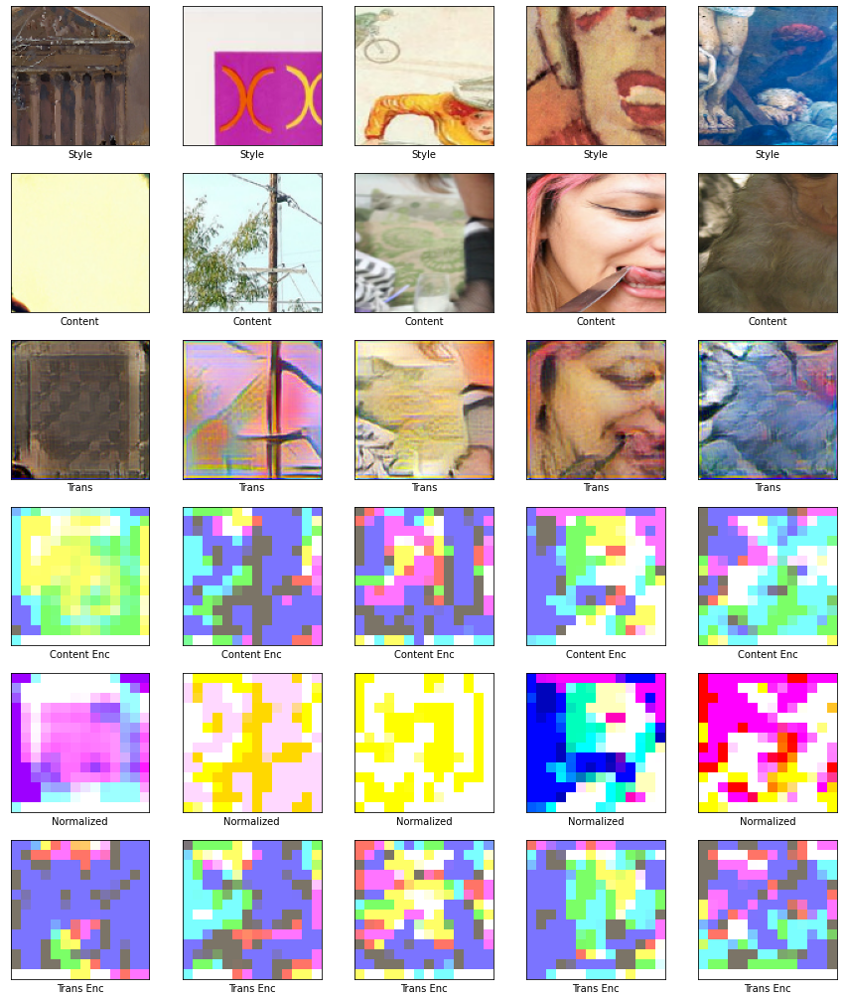

Epoch 25/30
  750/750 - loss: 789,133.12 - content loss: 332,146.59 - style loss: 456,986.50


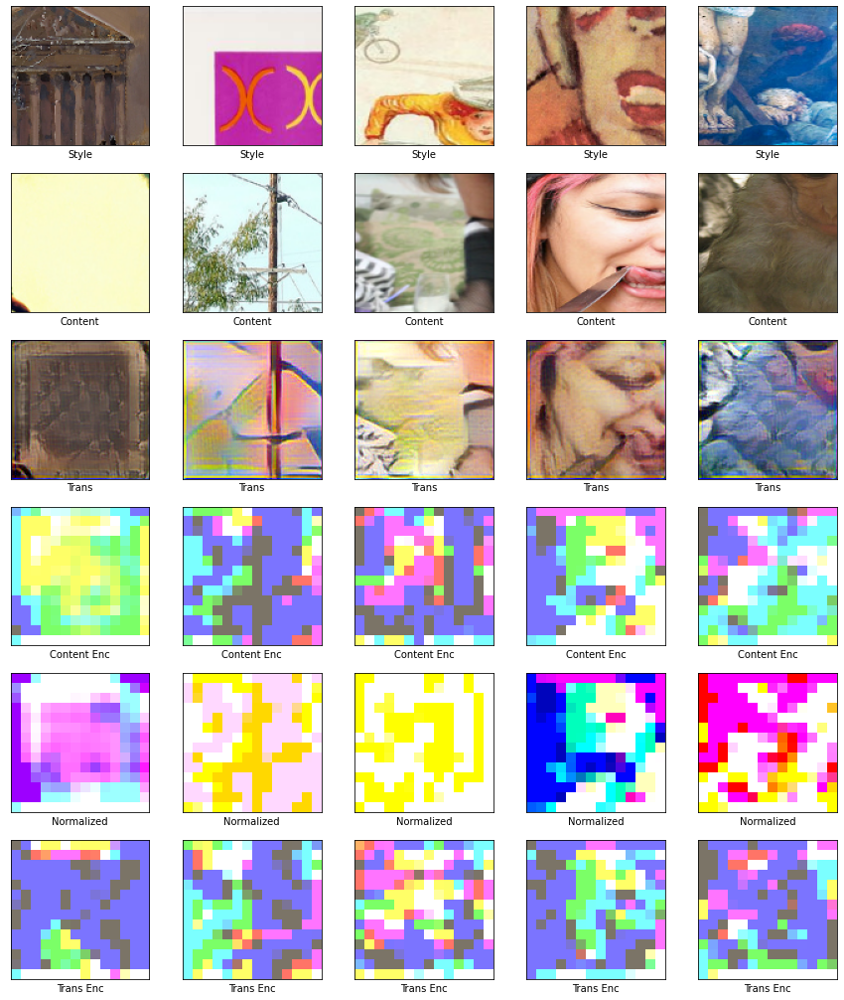

Epoch 26/30
  750/750 - loss: 790,076.25 - content loss: 329,477.28 - style loss: 460,598.97


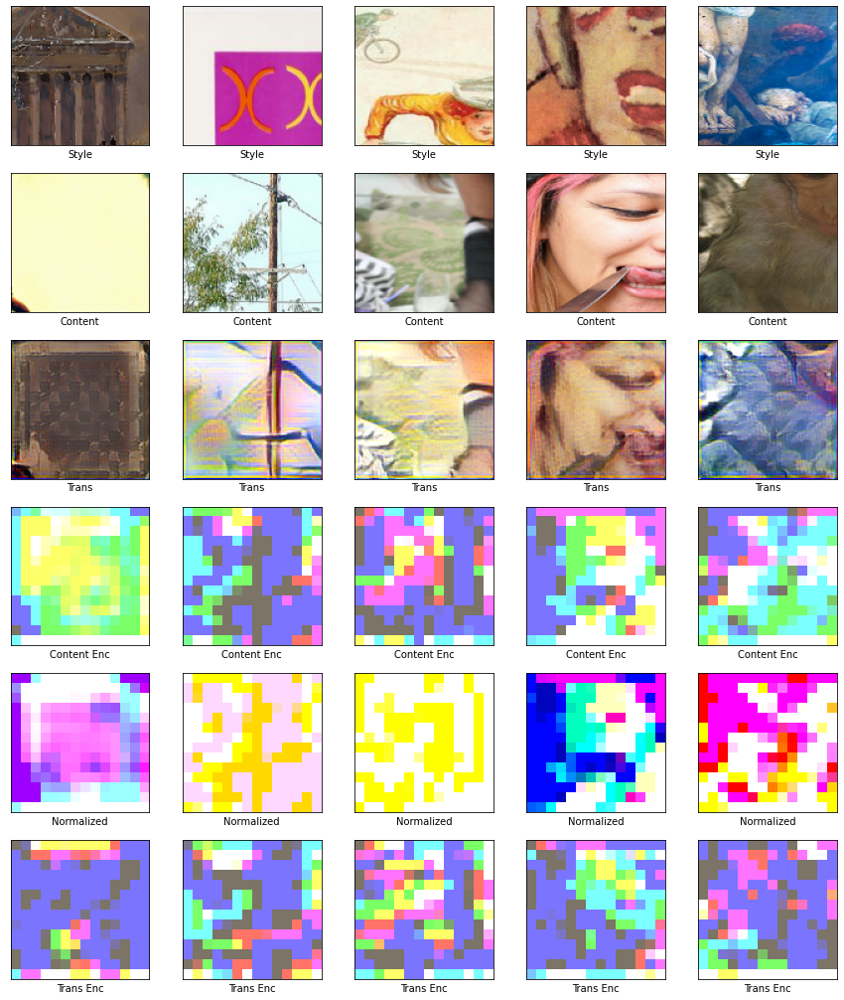

Epoch 27/30
  750/750 - loss: 779,011.38 - content loss: 328,957.72 - style loss: 450,053.69


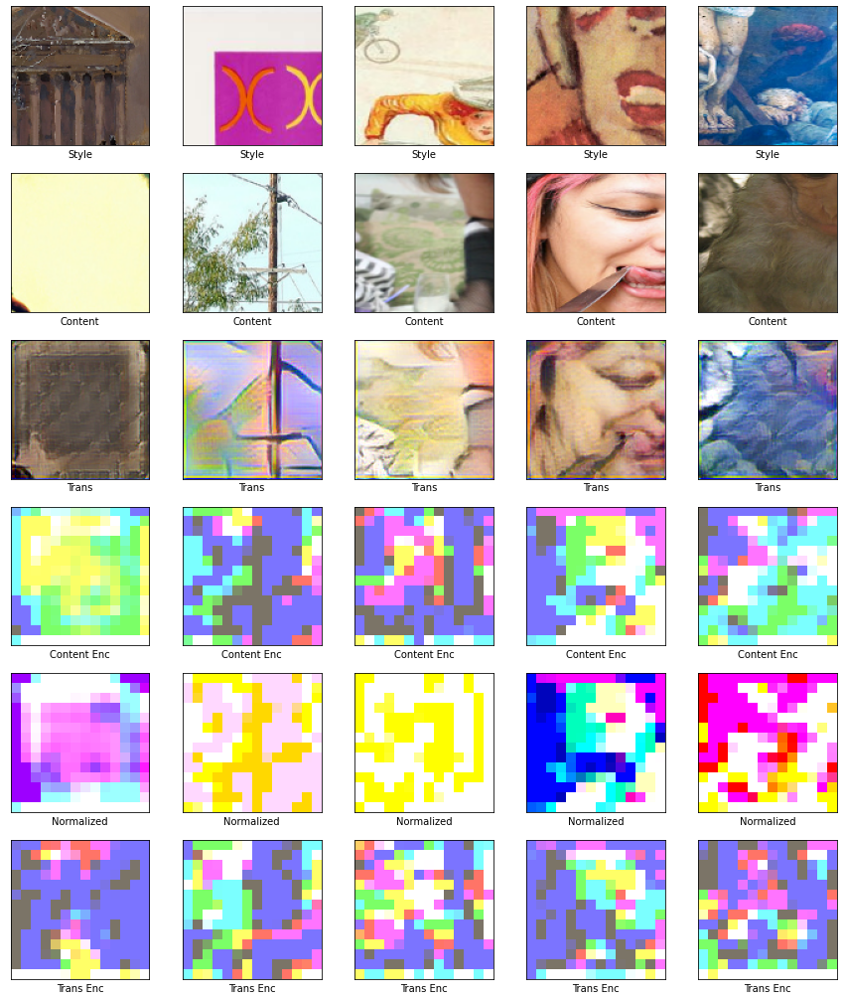

Epoch 28/30
  750/750 - loss: 803,878.12 - content loss: 332,001.38 - style loss: 471,876.75


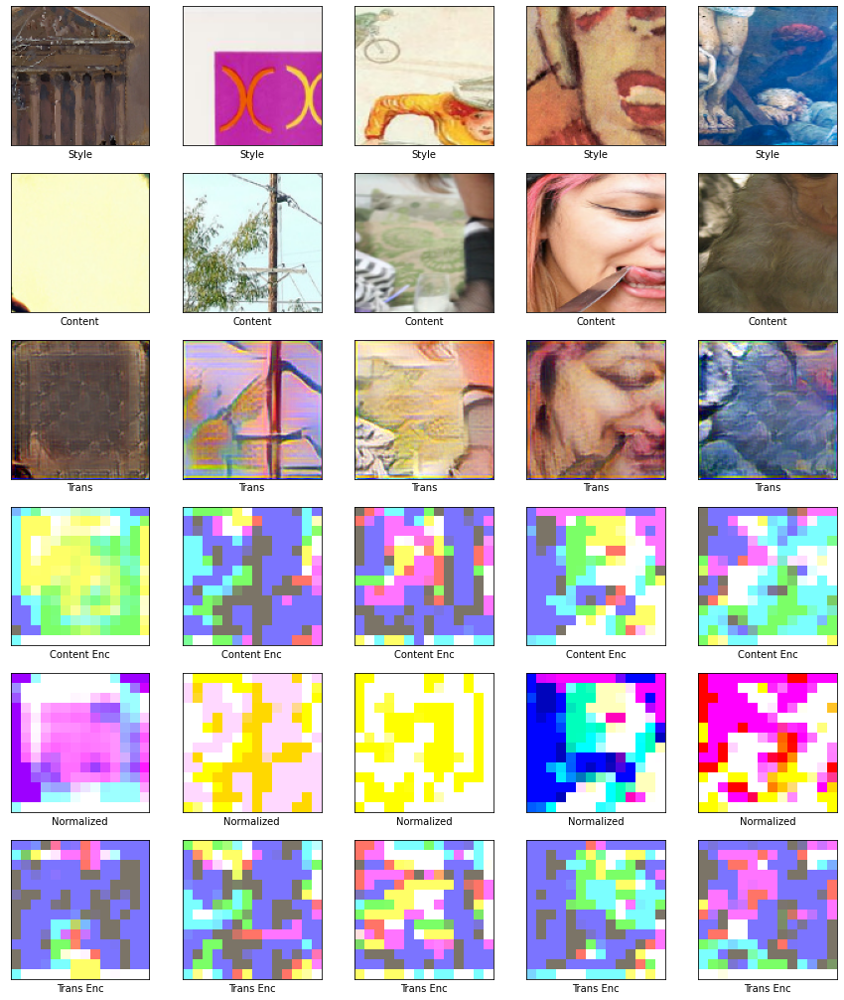

Epoch 29/30
  750/750 - loss: 770,021.19 - content loss: 325,660.28 - style loss: 444,360.91


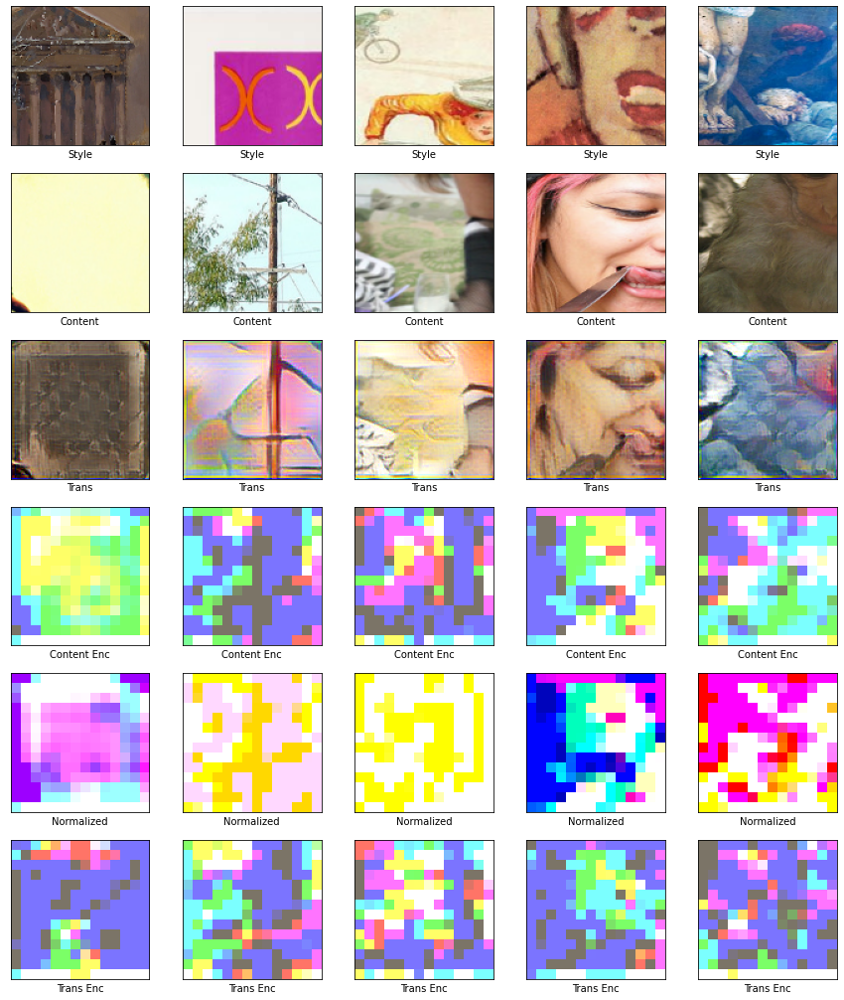

Epoch 30/30
  750/750 - loss: 769,847.88 - content loss: 325,462.25 - style loss: 444,385.62


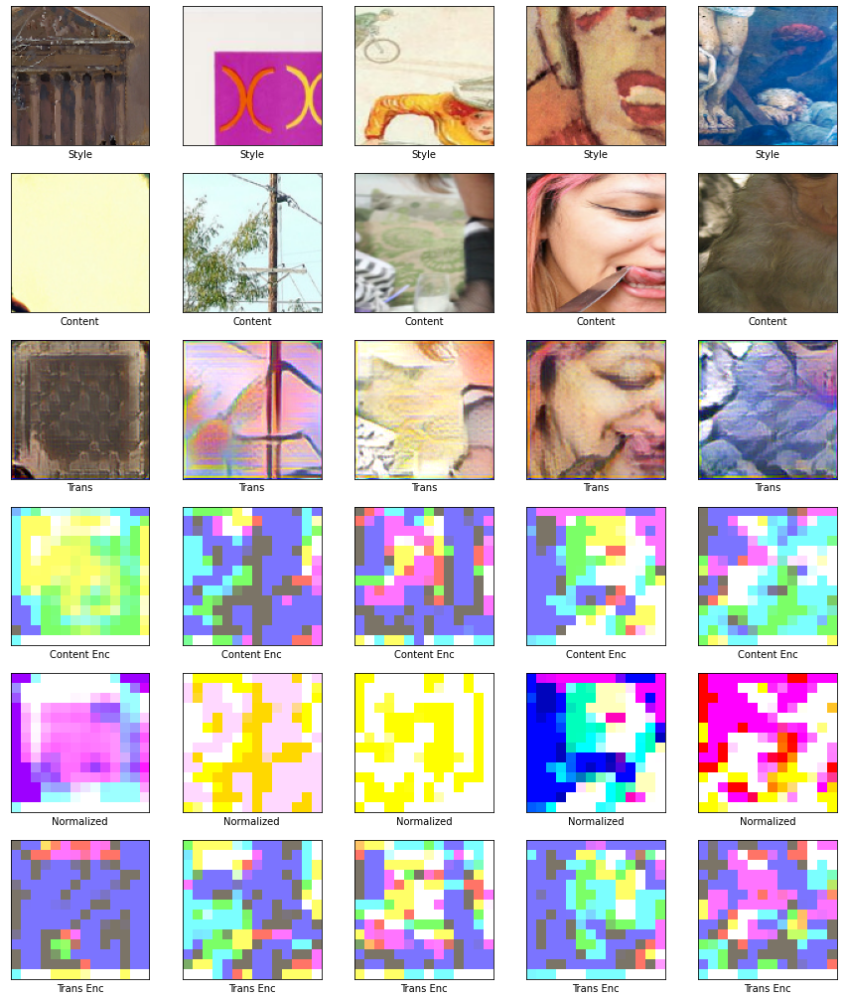

In [53]:
train(ds, init_epoch)

## Testing

Building dataset from 40,736 content images and 23,585 style images... done
Recovered loss: 819548.44


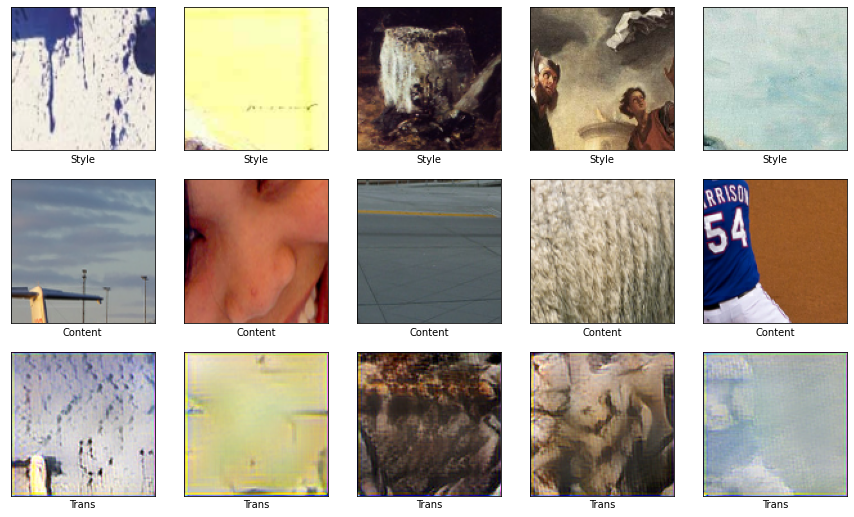

Recovered loss: 725082.25


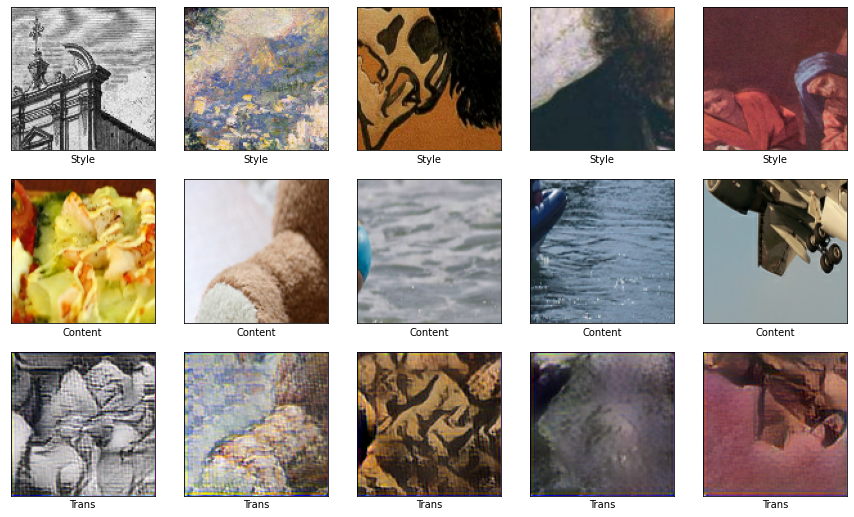

In [54]:
CKP_DIR = 'checkpoints/ckpt_20'

model = ArbitraryStyleTransferNet(img_shape=IMG_SHAPE)
model.load_weights(CKP_DIR)

ds = build_dataset()

for idx, (c_batch, s_batch) in enumerate(ds):
    if idx > 1:
        break
    output, c_enc_c, normalized_c, out_enc_c = model((c_batch, s_batch))
    print('Recovered loss:', tf.reduce_sum(model.losses).numpy())

    plot_outputs((s_batch, c_batch, output), ('Style', 'Content', 'Trans'))

## NTHU example

In [55]:
def preprocess_example(path, init_shape=(IMG_SHAPE[0], IMG_SHAPE[1])):
    image = tf.io.read_file(path)
    image = tf.image.decode_jpeg(image, channels=3)
    image = tf.image.resize(image, init_shape)
    image = tf.cast(image, tf.float32)
    
    # Convert image from RGB to BGR, then zero-center each color channel with
    # respect to the ImageNet dataset, without scaling.
    image = image[..., ::-1] # RGB to BGR
    image -= (103.939, 116.779, 123.68) # BGR means
    return image

def nthu_example(num_gpus=1):
    c_paths = ['./dataset/content_nthu.jpg']
    
    s_paths = []
    for s_dir in STYLE_DIRS:
        s_paths += Path(s_dir).glob('*.jpg')
    s_paths = [str(path.resolve()) for path in s_paths]
    print(f'Building dataset from {len(c_paths):,} content images and {len(s_paths):,} style images... ', end='')
    
    AUTOTUNE = tf.data.experimental.AUTOTUNE
    
    c_ds = tf.data.Dataset.from_tensor_slices(c_paths)
    c_ds = c_ds.map(preprocess_example, num_parallel_calls=AUTOTUNE)
    c_ds = c_ds.repeat()
    c_ds = c_ds.shuffle(buffer_size=SHUFFLE_BUFFER)
    
    s_ds = tf.data.Dataset.from_tensor_slices(s_paths)
    s_ds = s_ds.map(preprocess_image, num_parallel_calls=AUTOTUNE)
    s_ds = s_ds.repeat()
    s_ds = s_ds.shuffle(buffer_size=SHUFFLE_BUFFER)
    
    ds = tf.data.Dataset.zip((c_ds, s_ds))
    ds = ds.batch(BATCH_SIZE * num_gpus)
    ds = ds.prefetch(buffer_size=AUTOTUNE)
    
    print('done')
    return ds

Building dataset from 1 content images and 23,585 style images... done


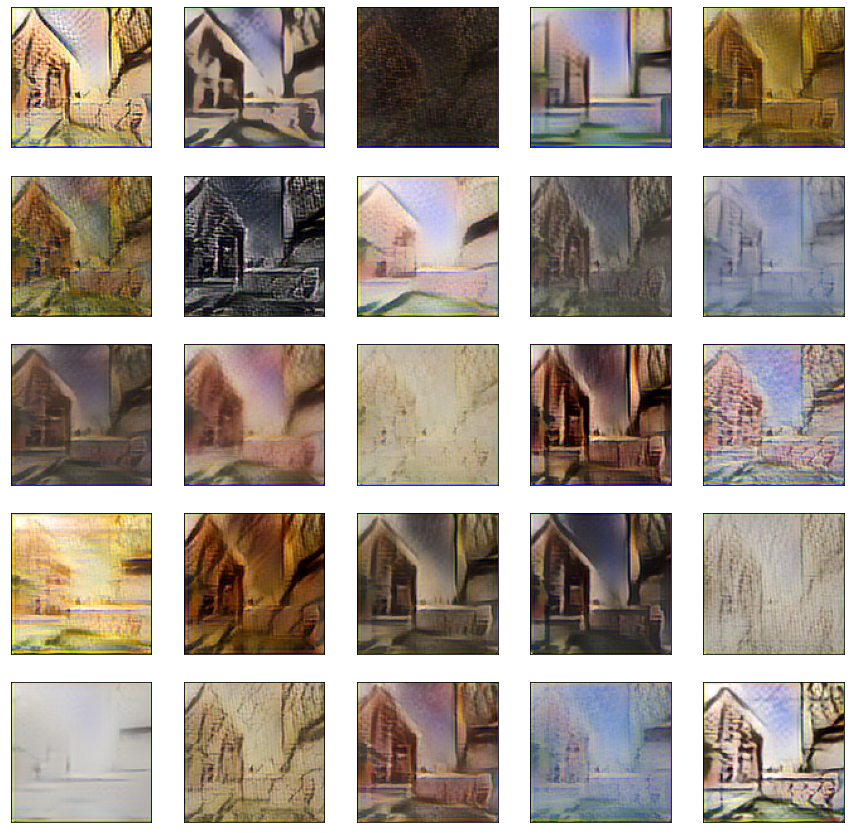

In [56]:
ds = nthu_example()
outputs = []

for idx, (c_batch, s_batch) in enumerate(ds):
    if idx > 4:
        break
    output, c_enc_c, normalized_c, out_enc_c = model((c_batch, s_batch))
    outputs.append(output)
    
plot_outputs((outputs))